# Afriat

In [1]:
scan=0.14

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: duelxhtf
Name: lemon-morning-110
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/duelxhtf
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-duelxhtf/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100 80GB PCIe') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2552,3281,9410
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2552,2586,1687,3432,1656,3330
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4473,10770
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 653,828,2329
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 653,616,421,858,393,869
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1111,2699
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:11<1:53:57, 11.42s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:53:57, 11.42s/it, v_num=tf_1, total_loss_train=3.71e+3, kl_local_train=43.3]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:53:57, 11.42s/it, v_num=tf_1, total_loss_train=3.71e+3, kl_local_train=43.3]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:21,  7.76s/it, v_num=tf_1, total_loss_train=3.71e+3, kl_local_train=43.3]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:21,  7.76s/it, v_num=tf_1, total_loss_train=3.21e+3, kl_local_train=56.5]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:21,  7.76s/it, v_num=tf_1, total_loss_train=3.21e+3, kl_local_train=56.5]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:20,  6.57s/it, v_num=tf_1, total_loss_train=3.21e+3, kl_local_train=56.5]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:21<1:05:20,  6.57s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=55.2]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:21<1:05:20,  6.57s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=55.2]

Epoch 4/600:   1%|█                                                                                                                                                          | 4/600 [00:26<59:40,  6.01s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=55.2]

Epoch 4/600:   1%|█                                                                                                                                                          | 4/600 [00:26<59:40,  6.01s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=51.7]

Epoch 5/600:   1%|█                                                                                                                                                          | 4/600 [00:26<59:40,  6.01s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=51.7]

Epoch 5/600:   1%|█▎                                                                                                                                                         | 5/600 [00:32<56:34,  5.71s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=51.7]

Epoch 5/600:   1%|█▎                                                                                                                                                         | 5/600 [00:32<56:34,  5.71s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=46.8]

Epoch 6/600:   1%|█▎                                                                                                                                                         | 5/600 [00:33<56:34,  5.71s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=46.8]

Epoch 6/600:   1%|█▌                                                                                                                                                         | 6/600 [00:38<58:01,  5.86s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=46.8]

Epoch 6/600:   1%|▏                     | 6/600 [00:38<58:01,  5.86s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|▏                     | 6/600 [00:38<58:01,  5.86s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|▎                     | 7/600 [00:43<55:39,  5.63s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|▎                     | 7/600 [00:43<55:39,  5.63s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=31.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▎                     | 7/600 [00:43<55:39,  5.63s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=31.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▎                     | 8/600 [00:48<54:00,  5.47s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=31.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▎                     | 8/600 [00:48<54:00,  5.47s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=26.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   1%|▎                     | 8/600 [00:48<54:00,  5.47s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=26.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▎                     | 9/600 [00:53<52:57,  5.38s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=26.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▎                     | 9/600 [00:53<52:57,  5.38s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▎                    | 9/600 [00:53<52:57,  5.38s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▎                   | 10/600 [00:58<52:09,  5.30s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=24.1, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▎                     | 10/600 [00:58<52:09,  5.30s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=27, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▎                     | 10/600 [00:59<52:09,  5.30s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=27, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▍                     | 11/600 [01:04<54:36,  5.56s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=27, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00721, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▍                    | 11/600 [01:04<54:36,  5.56s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=31.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▍                    | 11/600 [01:05<54:36,  5.56s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=31.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▍                    | 12/600 [01:10<53:14,  5.43s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=31.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▍                    | 12/600 [01:10<53:14,  5.43s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▍                    | 12/600 [01:10<53:14,  5.43s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▍                    | 13/600 [01:15<52:17,  5.34s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▍                    | 13/600 [01:15<52:17,  5.34s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▍                    | 13/600 [01:15<52:17,  5.34s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▍                    | 14/600 [01:20<51:35,  5.28s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▍                    | 14/600 [01:20<51:35,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▍                    | 14/600 [01:20<51:35,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▌                    | 15/600 [01:25<51:08,  5.25s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▌                    | 15/600 [01:25<51:08,  5.25s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=56.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 16/600:   2%|▌                    | 15/600 [01:26<51:08,  5.25s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=56.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 16/600:   3%|▌                    | 16/600 [01:31<53:40,  5.52s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=56.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.0725, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0476]

Epoch 16/600:   3%|▌                     | 16/600 [01:31<53:40,  5.52s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 17/600:   3%|▌                     | 16/600 [01:31<53:40,  5.52s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 17/600:   3%|▌                     | 17/600 [01:36<52:32,  5.41s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=61.7, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 17/600:   3%|▋                       | 17/600 [01:36<52:32,  5.41s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 18/600:   3%|▋                       | 17/600 [01:36<52:32,  5.41s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 18/600:   3%|▋                       | 18/600 [01:42<51:42,  5.33s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 18/600:   3%|▋                     | 18/600 [01:42<51:42,  5.33s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 19/600:   3%|▋                     | 18/600 [01:42<51:42,  5.33s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 19/600:   3%|▋                     | 19/600 [01:47<51:07,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=73.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 19/600:   3%|▋                     | 19/600 [01:47<51:07,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 20/600:   3%|▋                     | 19/600 [01:47<51:07,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 20/600:   3%|▋                     | 20/600 [01:52<50:40,  5.24s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=81.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 20/600:   3%|▋                     | 20/600 [01:52<50:40,  5.24s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=89.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 21/600:   3%|▋                     | 20/600 [01:53<50:40,  5.24s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=89.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 21/600:   4%|▊                     | 21/600 [01:58<53:13,  5.52s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=89.8, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.054, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0773]

Epoch 21/600:   4%|▋                    | 21/600 [01:58<53:13,  5.52s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 22/600:   4%|▋                    | 21/600 [01:58<53:13,  5.52s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 22/600:   4%|▊                    | 22/600 [02:03<52:05,  5.41s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 22/600:   4%|▊                     | 22/600 [02:03<52:05,  5.41s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=100, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 23/600:   4%|▊                     | 22/600 [02:03<52:05,  5.41s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=100, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 23/600:   4%|▊                     | 23/600 [02:08<51:16,  5.33s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=100, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 23/600:   4%|▊                     | 23/600 [02:08<51:16,  5.33s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 24/600:   4%|▊                     | 23/600 [02:08<51:16,  5.33s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 24/600:   4%|▉                     | 24/600 [02:13<50:43,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=102, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 24/600:   4%|▉                     | 24/600 [02:13<50:43,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=105, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 25/600:   4%|▉                     | 24/600 [02:13<50:43,  5.28s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=105, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 25/600:   4%|▉                     | 25/600 [02:19<50:13,  5.24s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=105, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 25/600:   4%|▉                     | 25/600 [02:19<50:13,  5.24s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=108, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 26/600:   4%|▉                     | 25/600 [02:20<50:13,  5.24s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=108, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 26/600:   4%|▉                     | 26/600 [02:25<52:42,  5.51s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=108, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0841, metric_mi|mouse_train=0.0966]

Epoch 26/600:   4%|█                       | 26/600 [02:25<52:42,  5.51s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 27/600:   4%|█                       | 26/600 [02:25<52:42,  5.51s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 27/600:   4%|█                       | 27/600 [02:30<51:36,  5.40s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 27/600:   4%|█                       | 27/600 [02:30<51:36,  5.40s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 28/600:   4%|█                       | 27/600 [02:30<51:36,  5.40s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 28/600:   5%|█                       | 28/600 [02:35<50:47,  5.33s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=109, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 28/600:   5%|█                       | 28/600 [02:35<50:47,  5.33s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 29/600:   5%|█                       | 28/600 [02:35<50:47,  5.33s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 29/600:   5%|█▏                      | 29/600 [02:40<50:12,  5.28s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 29/600:   5%|█▏                      | 29/600 [02:40<50:12,  5.28s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 30/600:   5%|█▏                      | 29/600 [02:40<50:12,  5.28s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 30/600:   5%|█▏                      | 30/600 [02:45<49:47,  5.24s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 30/600:   5%|█▏                      | 30/600 [02:45<49:47,  5.24s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 31/600:   5%|█▏                      | 30/600 [02:46<49:47,  5.24s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 31/600:   5%|█▏                      | 31/600 [02:52<52:17,  5.51s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=110, metric_mi|status_control_train=0.0985, metric_mi|zone_train=0.0802, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.111]

Epoch 31/600:   5%|█▍                         | 31/600 [02:52<52:17,  5.51s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▍                         | 31/600 [02:52<52:17,  5.51s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▍                         | 32/600 [02:57<51:10,  5.41s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=108, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▍                         | 32/600 [02:57<51:10,  5.41s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 33/600:   5%|█▍                         | 32/600 [02:57<51:10,  5.41s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|█▍                         | 33/600 [03:02<50:23,  5.33s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=109, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|█▍                         | 33/600 [03:02<50:23,  5.33s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▍                         | 33/600 [03:02<50:23,  5.33s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▌                         | 34/600 [03:07<49:48,  5.28s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▌                         | 34/600 [03:07<49:48,  5.28s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▌                         | 34/600 [03:07<49:48,  5.28s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▌                         | 35/600 [03:12<49:23,  5.25s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▌                         | 35/600 [03:12<49:23,  5.25s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                         | 35/600 [03:13<49:23,  5.25s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                         | 36/600 [03:18<51:55,  5.52s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                        | 36/600 [03:18<51:55,  5.52s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|█▌                        | 36/600 [03:18<51:55,  5.52s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|█▌                        | 37/600 [03:23<50:48,  5.41s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|█▌                        | 37/600 [03:23<50:48,  5.41s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|█▌                        | 37/600 [03:24<50:48,  5.41s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|█▋                        | 38/600 [03:29<49:58,  5.34s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|█▋                        | 38/600 [03:29<49:58,  5.34s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|█▋                        | 38/600 [03:29<49:58,  5.34s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|█▋                        | 39/600 [03:34<49:24,  5.28s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|█▋                        | 39/600 [03:34<49:24,  5.28s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 40/600:   6%|█▋                        | 39/600 [03:34<49:24,  5.28s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|█▋                        | 40/600 [03:39<48:57,  5.25s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|█▋                        | 40/600 [03:39<48:57,  5.25s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|█▋                        | 40/600 [03:40<48:57,  5.25s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|█▊                        | 41/600 [03:45<51:25,  5.52s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|█▊                        | 41/600 [03:45<51:25,  5.52s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|█▊                        | 41/600 [03:45<51:25,  5.52s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|█▊                        | 42/600 [03:50<50:19,  5.41s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|█▊                        | 42/600 [03:50<50:19,  5.41s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|█▊                        | 42/600 [03:50<50:19,  5.41s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|█▊                        | 43/600 [03:55<49:31,  5.34s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|█▊                        | 43/600 [03:55<49:31,  5.34s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|█▊                        | 43/600 [03:55<49:31,  5.34s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|█▉                        | 44/600 [04:01<48:56,  5.28s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|█▉                        | 44/600 [04:01<48:56,  5.28s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 45/600:   7%|█▉                        | 44/600 [04:01<48:56,  5.28s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|█▉                        | 45/600 [04:06<48:33,  5.25s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=108, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|█▉                        | 45/600 [04:06<48:33,  5.25s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|█▉                        | 45/600 [04:07<48:33,  5.25s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|█▉                        | 46/600 [04:12<50:57,  5.52s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|██▏                         | 46/600 [04:12<50:57,  5.52s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 47/600:   8%|██▏                         | 46/600 [04:12<50:57,  5.52s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 47/600:   8%|██▏                         | 47/600 [04:17<49:50,  5.41s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 47/600:   8%|██▎                          | 47/600 [04:17<49:50,  5.41s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 48/600:   8%|██▎                          | 47/600 [04:17<49:50,  5.41s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 48/600:   8%|██▎                          | 48/600 [04:22<49:02,  5.33s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 48/600:   8%|██▎                          | 48/600 [04:22<49:02,  5.33s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 49/600:   8%|██▎                          | 48/600 [04:22<49:02,  5.33s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 49/600:   8%|██▎                          | 49/600 [04:27<48:26,  5.28s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 49/600:   8%|██▎                          | 49/600 [04:27<48:26,  5.28s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 50/600:   8%|██▎                          | 49/600 [04:27<48:26,  5.28s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 50/600:   8%|██▍                          | 50/600 [04:32<47:58,  5.23s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 50/600:   8%|██▍                          | 50/600 [04:32<47:58,  5.23s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 51/600:   8%|██▍                          | 50/600 [04:33<47:58,  5.23s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 51/600:   8%|██▍                          | 51/600 [04:39<50:23,  5.51s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 51/600:   8%|██▍                         | 51/600 [04:39<50:23,  5.51s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 52/600:   8%|██▍                         | 51/600 [04:39<50:23,  5.51s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|██▍                         | 52/600 [04:44<49:31,  5.42s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|██▍                         | 52/600 [04:44<49:31,  5.42s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|██▍                         | 52/600 [04:44<49:31,  5.42s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|██▍                         | 53/600 [04:49<48:46,  5.35s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=107, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|██▍                         | 53/600 [04:49<48:46,  5.35s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|██▍                         | 53/600 [04:49<48:46,  5.35s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|██▌                         | 54/600 [04:54<48:08,  5.29s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|██▌                         | 54/600 [04:54<48:08,  5.29s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|██▌                         | 54/600 [04:54<48:08,  5.29s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|██▌                         | 55/600 [04:59<47:40,  5.25s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|██▌                         | 55/600 [04:59<47:40,  5.25s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|██▌                         | 55/600 [05:00<47:40,  5.25s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|██▌                         | 56/600 [05:06<50:26,  5.56s/it, v_num=tf_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|██▍                       | 56/600 [05:06<50:26,  5.56s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:   9%|██▍                       | 56/600 [05:06<50:26,  5.56s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                       | 57/600 [05:11<49:14,  5.44s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 57/600:  10%|██▍                       | 57/600 [05:11<49:14,  5.44s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▍                       | 57/600 [05:11<49:14,  5.44s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▌                       | 58/600 [05:16<48:24,  5.36s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 58/600:  10%|██▌                       | 58/600 [05:16<48:24,  5.36s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 58/600 [05:16<48:24,  5.36s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 59/600 [05:21<47:53,  5.31s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 59/600:  10%|██▌                       | 59/600 [05:21<47:53,  5.31s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 59/600 [05:21<47:53,  5.31s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 60/600 [05:26<47:14,  5.25s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 60/600:  10%|██▌                       | 60/600 [05:26<47:14,  5.25s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▌                       | 60/600 [05:27<47:14,  5.25s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▋                       | 61/600 [05:32<49:25,  5.50s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.128]

Epoch 61/600:  10%|██▋                       | 61/600 [05:32<49:25,  5.50s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 62/600:  10%|██▋                       | 61/600 [05:32<49:25,  5.50s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 62/600:  10%|██▋                       | 62/600 [05:37<48:19,  5.39s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 62/600:  10%|██▌                      | 62/600 [05:37<48:19,  5.39s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 63/600:  10%|██▌                      | 62/600 [05:38<48:19,  5.39s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 63/600:  10%|██▋                      | 63/600 [05:43<47:39,  5.32s/it, v_num=tf_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 63/600:  10%|██▋                      | 63/600 [05:43<47:39,  5.32s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=98.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 64/600:  10%|██▋                      | 63/600 [05:43<47:39,  5.32s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=98.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 64/600:  11%|██▋                      | 64/600 [05:48<47:10,  5.28s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=98.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 64/600:  11%|██▋                      | 64/600 [05:48<47:10,  5.28s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=97.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 65/600:  11%|██▋                      | 64/600 [05:48<47:10,  5.28s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=97.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 65/600:  11%|██▋                      | 65/600 [05:53<46:47,  5.25s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=97.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 65/600:  11%|██▋                      | 65/600 [05:53<46:47,  5.25s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 66/600:  11%|██▋                      | 65/600 [05:54<46:47,  5.25s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 66/600:  11%|██▊                      | 66/600 [05:59<49:04,  5.51s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 66/600:  11%|██▊                      | 66/600 [05:59<49:04,  5.51s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=95.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|██▊                      | 66/600 [05:59<49:04,  5.51s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=95.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|██▊                      | 67/600 [06:04<47:57,  5.40s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=95.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 67/600:  11%|██▊                      | 67/600 [06:04<47:57,  5.40s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=95.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|██▊                      | 67/600 [06:04<47:57,  5.40s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=95.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|██▊                      | 68/600 [06:09<47:02,  5.30s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=95.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 68/600:  11%|██▊                      | 68/600 [06:09<47:02,  5.30s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=93.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 69/600:  11%|██▊                      | 68/600 [06:09<47:02,  5.30s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=93.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 69/600:  12%|██▉                      | 69/600 [06:14<46:24,  5.24s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=93.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 69/600:  12%|██▉                      | 69/600 [06:14<46:24,  5.24s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|██▉                      | 69/600 [06:14<46:24,  5.24s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|██▉                      | 70/600 [06:20<45:55,  5.20s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=93.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 70/600:  12%|██▉                      | 70/600 [06:20<45:55,  5.20s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=92.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|██▉                      | 70/600 [06:21<45:55,  5.20s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=92.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|██▉                      | 71/600 [06:26<48:10,  5.46s/it, v_num=tf_1, total_loss_train=3.18e+3, kl_local_train=92.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 71/600:  12%|██▉                      | 71/600 [06:26<48:10,  5.46s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|██▉                      | 71/600 [06:26<48:10,  5.46s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|███                      | 72/600 [06:31<47:05,  5.35s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|███                      | 72/600 [06:31<47:05,  5.35s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|███                      | 72/600 [06:31<47:05,  5.35s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|███                      | 73/600 [06:36<46:18,  5.27s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|███                      | 73/600 [06:36<46:18,  5.27s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|███                      | 73/600 [06:36<46:18,  5.27s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|███                      | 74/600 [06:41<46:12,  5.27s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=90.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|███                      | 74/600 [06:41<46:12,  5.27s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|███                      | 74/600 [06:41<46:12,  5.27s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|███▏                     | 75/600 [06:46<45:46,  5.23s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|███▏                     | 75/600 [06:46<45:46,  5.23s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 76/600:  12%|███▏                     | 75/600 [06:47<45:46,  5.23s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 76/600:  13%|███▏                     | 76/600 [06:52<48:00,  5.50s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.121]

Epoch 76/600:  13%|███▎                      | 76/600 [06:52<48:00,  5.50s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 77/600:  13%|███▎                      | 76/600 [06:52<48:00,  5.50s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 77/600:  13%|███▎                      | 77/600 [06:57<46:57,  5.39s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=88.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 77/600:  13%|███▌                        | 77/600 [06:57<46:57,  5.39s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=87, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 78/600:  13%|███▌                        | 77/600 [06:57<46:57,  5.39s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=87, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 78/600:  13%|███▋                        | 78/600 [07:03<46:11,  5.31s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=87, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 78/600:  13%|███▍                      | 78/600 [07:03<46:11,  5.31s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=86.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 79/600:  13%|███▍                      | 78/600 [07:03<46:11,  5.31s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=86.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 79/600:  13%|███▍                      | 79/600 [07:08<45:37,  5.25s/it, v_num=tf_1, total_loss_train=3.17e+3, kl_local_train=86.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 79/600:  13%|███▍                      | 79/600 [07:08<45:37,  5.25s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=85.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 80/600:  13%|███▍                      | 79/600 [07:08<45:37,  5.25s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=85.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 80/600:  13%|███▍                      | 80/600 [07:13<45:10,  5.21s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=85.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 80/600:  13%|███▍                      | 80/600 [07:13<45:10,  5.21s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 81/600:  13%|███▍                      | 80/600 [07:14<45:10,  5.21s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 81/600:  14%|███▌                      | 81/600 [07:19<47:26,  5.48s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=85.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.123]

Epoch 81/600:  14%|███▍                     | 81/600 [07:19<47:26,  5.48s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 82/600:  14%|███▍                     | 81/600 [07:19<47:26,  5.48s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 82/600:  14%|███▍                     | 82/600 [07:24<46:26,  5.38s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 82/600:  14%|███▍                     | 82/600 [07:24<46:26,  5.38s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 83/600:  14%|███▍                     | 82/600 [07:24<46:26,  5.38s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 83/600:  14%|███▍                     | 83/600 [07:29<45:41,  5.30s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 83/600:  14%|███▍                     | 83/600 [07:29<45:41,  5.30s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 84/600:  14%|███▍                     | 83/600 [07:29<45:41,  5.30s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 84/600:  14%|███▌                     | 84/600 [07:34<45:08,  5.25s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 84/600:  14%|███▊                       | 84/600 [07:34<45:08,  5.25s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 85/600:  14%|███▊                       | 84/600 [07:34<45:08,  5.25s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 85/600:  14%|███▊                       | 85/600 [07:39<44:38,  5.20s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=83, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 85/600:  14%|███▌                     | 85/600 [07:39<44:38,  5.20s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 86/600:  14%|███▌                     | 85/600 [07:40<44:38,  5.20s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 86/600:  14%|███▌                     | 86/600 [07:46<47:01,  5.49s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=82.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 86/600:  14%|███▋                      | 86/600 [07:46<47:01,  5.49s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 87/600:  14%|███▋                      | 86/600 [07:46<47:01,  5.49s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 87/600:  14%|███▊                      | 87/600 [07:51<46:02,  5.39s/it, v_num=tf_1, total_loss_train=3.16e+3, kl_local_train=81.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 87/600:  14%|███▊                      | 87/600 [07:51<46:02,  5.39s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 88/600:  14%|███▊                      | 87/600 [07:51<46:02,  5.39s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 88/600:  15%|███▊                      | 88/600 [07:56<45:22,  5.32s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=81.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 88/600:  15%|███▊                      | 88/600 [07:56<45:22,  5.32s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=80.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 89/600:  15%|███▊                      | 88/600 [07:56<45:22,  5.32s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=80.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 89/600:  15%|███▊                      | 89/600 [08:01<44:51,  5.27s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=80.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 89/600:  15%|███▊                      | 89/600 [08:01<44:51,  5.27s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=80.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 90/600:  15%|███▊                      | 89/600 [08:01<44:51,  5.27s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=80.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 90/600:  15%|███▉                      | 90/600 [08:06<44:29,  5.23s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=80.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 90/600:  15%|███▉                      | 90/600 [08:06<44:29,  5.23s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 91/600:  15%|███▉                      | 90/600 [08:07<44:29,  5.23s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 91/600:  15%|███▉                      | 91/600 [08:12<46:45,  5.51s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.121]

Epoch 91/600:  15%|███▉                      | 91/600 [08:12<46:45,  5.51s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=79.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 92/600:  15%|███▉                      | 91/600 [08:12<46:45,  5.51s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=79.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 92/600:  15%|███▉                      | 92/600 [08:18<45:43,  5.40s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=79.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 92/600:  15%|███▉                      | 92/600 [08:18<45:43,  5.40s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=78.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 93/600:  15%|███▉                      | 92/600 [08:18<45:43,  5.40s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=78.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 93/600:  16%|████                      | 93/600 [08:23<45:10,  5.35s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=78.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 93/600:  16%|████                      | 93/600 [08:23<45:10,  5.35s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 94/600:  16%|████                      | 93/600 [08:23<45:10,  5.35s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 94/600:  16%|████                      | 94/600 [08:28<44:34,  5.29s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 94/600:  16%|████                      | 94/600 [08:28<44:34,  5.29s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 95/600:  16%|████                      | 94/600 [08:28<44:34,  5.29s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 95/600:  16%|████                      | 95/600 [08:33<43:59,  5.23s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.9, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 95/600:  16%|████                      | 95/600 [08:33<43:59,  5.23s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 96/600:  16%|████                      | 95/600 [08:34<43:59,  5.23s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 96/600:  16%|████▏                     | 96/600 [08:39<46:10,  5.50s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 96/600:  16%|████▏                     | 96/600 [08:39<46:10,  5.50s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|████▏                     | 96/600 [08:39<46:10,  5.50s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|████▏                     | 97/600 [08:44<45:13,  5.40s/it, v_num=tf_1, total_loss_train=3.15e+3, kl_local_train=77.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|████▏                     | 97/600 [08:44<45:13,  5.40s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|████▏                     | 97/600 [08:44<45:13,  5.40s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|████▏                     | 98/600 [08:49<44:29,  5.32s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|████▌                       | 98/600 [08:49<44:29,  5.32s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|████▌                       | 98/600 [08:49<44:29,  5.32s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|████▌                       | 99/600 [08:55<43:55,  5.26s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|████▌                       | 99/600 [08:55<43:55,  5.26s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 100/600:  16%|████▍                      | 99/600 [08:55<43:55,  5.26s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 100/600:  17%|████▎                     | 100/600 [09:00<43:31,  5.22s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 100/600:  17%|████                    | 100/600 [09:00<43:31,  5.22s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|████                    | 100/600 [09:01<43:31,  5.22s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|████                    | 101/600 [09:06<45:41,  5.49s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|███▊                   | 101/600 [09:06<45:41,  5.49s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|███▊                   | 101/600 [09:06<45:41,  5.49s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|███▉                   | 102/600 [09:11<44:42,  5.39s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|███▉                   | 102/600 [09:11<44:42,  5.39s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|███▉                   | 102/600 [09:11<44:42,  5.39s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|███▉                   | 103/600 [09:16<44:02,  5.32s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|███▉                   | 103/600 [09:16<44:02,  5.32s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|███▉                   | 103/600 [09:16<44:02,  5.32s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|███▉                   | 104/600 [09:21<43:29,  5.26s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|███▉                   | 104/600 [09:21<43:29,  5.26s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=73.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 105/600:  17%|███▉                   | 104/600 [09:21<43:29,  5.26s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=73.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|████                   | 105/600 [09:26<43:06,  5.22s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=73.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|████                   | 105/600 [09:26<43:06,  5.22s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|████                   | 105/600 [09:27<43:06,  5.22s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|████                   | 106/600 [09:32<45:11,  5.49s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|████▏                   | 106/600 [09:32<45:11,  5.49s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 107/600:  18%|████▏                   | 106/600 [09:32<45:11,  5.49s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 107/600:  18%|████▎                   | 107/600 [09:38<44:11,  5.38s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=72.7, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 107/600:  18%|████▎                   | 107/600 [09:38<44:11,  5.38s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=72.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 108/600:  18%|████▎                   | 107/600 [09:38<44:11,  5.38s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=72.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 108/600:  18%|████▎                   | 108/600 [09:43<43:26,  5.30s/it, v_num=tf_1, total_loss_train=3.14e+3, kl_local_train=72.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 108/600:  18%|████▎                   | 108/600 [09:43<43:26,  5.30s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 109/600:  18%|████▎                   | 108/600 [09:43<43:26,  5.30s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 109/600:  18%|████▎                   | 109/600 [09:48<42:57,  5.25s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 109/600:  18%|████▎                   | 109/600 [09:48<42:57,  5.25s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 110/600:  18%|████▎                   | 109/600 [09:48<42:57,  5.25s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 110/600:  18%|████▍                   | 110/600 [09:53<42:32,  5.21s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 110/600:  18%|████▍                   | 110/600 [09:53<42:32,  5.21s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 111/600:  18%|████▍                   | 110/600 [09:54<42:32,  5.21s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 111/600:  18%|████▍                   | 111/600 [09:59<44:37,  5.48s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 111/600:  18%|████▎                  | 111/600 [09:59<44:37,  5.48s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 112/600:  18%|████▎                  | 111/600 [09:59<44:37,  5.48s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 112/600:  19%|████▎                  | 112/600 [10:04<43:42,  5.37s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 112/600:  19%|████▎                  | 112/600 [10:04<43:42,  5.37s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▎                  | 112/600 [10:04<43:42,  5.37s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▎                  | 113/600 [10:09<43:03,  5.30s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=71.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 113/600:  19%|████▎                  | 113/600 [10:09<43:03,  5.30s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▎                  | 113/600 [10:09<43:03,  5.30s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▎                  | 114/600 [10:14<42:35,  5.26s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 114/600:  19%|████▎                  | 114/600 [10:14<42:35,  5.26s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▎                  | 114/600 [10:14<42:35,  5.26s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▍                  | 115/600 [10:20<42:13,  5.22s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=70.1, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 115/600:  19%|████▍                  | 115/600 [10:20<42:13,  5.22s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▍                  | 115/600 [10:21<42:13,  5.22s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▍                  | 116/600 [10:26<44:19,  5.50s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.115]

Epoch 116/600:  19%|████▊                    | 116/600 [10:26<44:19,  5.50s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 117/600:  19%|████▊                    | 116/600 [10:26<44:19,  5.50s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 117/600:  20%|████▉                    | 117/600 [10:31<43:28,  5.40s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 117/600:  20%|████▉                    | 117/600 [10:31<43:28,  5.40s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 118/600:  20%|████▉                    | 117/600 [10:31<43:28,  5.40s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 118/600:  20%|████▉                    | 118/600 [10:36<42:44,  5.32s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=69.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 118/600:  20%|████▉                    | 118/600 [10:36<42:44,  5.32s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|████▉                    | 118/600 [10:36<42:44,  5.32s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|████▉                    | 119/600 [10:41<42:09,  5.26s/it, v_num=tf_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|████▉                    | 119/600 [10:41<42:09,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|████▉                    | 119/600 [10:41<42:09,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|█████                    | 120/600 [10:46<41:43,  5.21s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|█████                    | 120/600 [10:46<41:43,  5.21s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|█████                    | 120/600 [10:47<41:43,  5.21s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|█████                    | 121/600 [10:52<43:57,  5.51s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|████▊                   | 121/600 [10:52<43:57,  5.51s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 122/600:  20%|████▊                   | 121/600 [10:52<43:57,  5.51s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 122/600:  20%|████▉                   | 122/600 [10:58<43:00,  5.40s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 122/600:  20%|████▉                   | 122/600 [10:58<43:00,  5.40s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|████▉                   | 122/600 [10:58<43:00,  5.40s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|████▉                   | 123/600 [11:03<42:15,  5.32s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|████▉                   | 123/600 [11:03<42:15,  5.32s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 124/600:  20%|████▉                   | 123/600 [11:03<42:15,  5.32s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 124/600:  21%|████▉                   | 124/600 [11:08<41:42,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 124/600:  21%|█████▎                    | 124/600 [11:08<41:42,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|█████▎                    | 124/600 [11:08<41:42,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|█████▍                    | 125/600 [11:13<41:18,  5.22s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|█████                   | 125/600 [11:13<41:18,  5.22s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|█████                   | 125/600 [11:14<41:18,  5.22s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|█████                   | 126/600 [11:19<43:24,  5.49s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|█████                   | 126/600 [11:19<43:24,  5.49s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|█████                   | 126/600 [11:19<43:24,  5.49s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|█████                   | 127/600 [11:24<42:29,  5.39s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|█████                   | 127/600 [11:24<42:29,  5.39s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|█████                   | 127/600 [11:24<42:29,  5.39s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|█████                   | 128/600 [11:29<41:48,  5.31s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|█████                   | 128/600 [11:29<41:48,  5.31s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 129/600:  21%|█████                   | 128/600 [11:29<41:48,  5.31s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|█████▏                  | 129/600 [11:35<41:19,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|█████▏                  | 129/600 [11:35<41:19,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|█████▏                  | 129/600 [11:35<41:19,  5.26s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|█████▏                  | 130/600 [11:40<41:27,  5.29s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|█████▏                  | 130/600 [11:40<41:27,  5.29s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|█████▏                  | 130/600 [11:41<41:27,  5.29s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|█████▏                  | 131/600 [11:46<43:24,  5.55s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|█████                  | 131/600 [11:46<43:24,  5.55s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|█████                  | 131/600 [11:46<43:24,  5.55s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|█████                  | 132/600 [11:51<42:20,  5.43s/it, v_num=tf_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 132/600:  22%|█████                  | 132/600 [11:51<42:20,  5.43s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|█████                  | 132/600 [11:51<42:20,  5.43s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|█████                  | 133/600 [11:56<41:35,  5.34s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 133/600:  22%|█████                  | 133/600 [11:56<41:35,  5.34s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|█████                  | 133/600 [11:56<41:35,  5.34s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|█████▏                 | 134/600 [12:01<41:02,  5.29s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 134/600:  22%|█████▏                 | 134/600 [12:01<41:02,  5.29s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|█████▏                 | 134/600 [12:01<41:02,  5.29s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|█████▏                 | 135/600 [12:07<40:36,  5.24s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 135/600:  22%|█████▏                 | 135/600 [12:07<40:36,  5.24s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 136/600:  22%|█████▏                 | 135/600 [12:08<40:36,  5.24s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 136/600:  23%|█████▏                 | 136/600 [12:13<42:35,  5.51s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 136/600:  23%|█████▍                  | 136/600 [12:13<42:35,  5.51s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|█████▍                  | 136/600 [12:13<42:35,  5.51s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|█████▍                  | 137/600 [12:18<41:42,  5.41s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 137/600:  23%|█████▍                  | 137/600 [12:18<41:42,  5.41s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████▍                  | 137/600 [12:18<41:42,  5.41s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████▌                  | 138/600 [12:23<41:00,  5.33s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 138/600:  23%|█████▌                  | 138/600 [12:23<41:00,  5.33s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████▌                  | 138/600 [12:23<41:00,  5.33s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████▌                  | 139/600 [12:28<40:30,  5.27s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 139/600:  23%|█████▌                  | 139/600 [12:28<40:30,  5.27s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████▌                  | 139/600 [12:28<40:30,  5.27s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████▌                  | 140/600 [12:33<40:07,  5.23s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 140/600:  23%|█████▌                  | 140/600 [12:33<40:07,  5.23s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 141/600:  23%|█████▌                  | 140/600 [12:34<40:07,  5.23s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 141/600:  24%|█████▋                  | 141/600 [12:39<42:07,  5.51s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 141/600:  24%|█████▋                  | 141/600 [12:39<42:07,  5.51s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 142/600:  24%|█████▋                  | 141/600 [12:40<42:07,  5.51s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 142/600:  24%|█████▋                  | 142/600 [12:45<41:14,  5.40s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 142/600:  24%|██████▏                   | 142/600 [12:45<41:14,  5.40s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 143/600:  24%|██████▏                   | 142/600 [12:45<41:14,  5.40s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 143/600:  24%|██████▏                   | 143/600 [12:50<40:35,  5.33s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=63, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 143/600:  24%|█████▋                  | 143/600 [12:50<40:35,  5.33s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 144/600:  24%|█████▋                  | 143/600 [12:50<40:35,  5.33s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 144/600:  24%|█████▊                  | 144/600 [12:55<40:04,  5.27s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=62.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 144/600:  24%|█████▊                  | 144/600 [12:55<40:04,  5.27s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 145/600:  24%|█████▊                  | 144/600 [12:55<40:04,  5.27s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 145/600:  24%|█████▊                  | 145/600 [13:00<39:37,  5.23s/it, v_num=tf_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 145/600:  24%|██████                   | 145/600 [13:00<39:37,  5.23s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 146/600:  24%|██████                   | 145/600 [13:01<39:37,  5.23s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 146/600:  24%|██████                   | 146/600 [13:06<41:37,  5.50s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.107]

Epoch 146/600:  24%|█████▊                  | 146/600 [13:06<41:37,  5.50s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|█████▊                  | 146/600 [13:06<41:37,  5.50s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|█████▉                  | 147/600 [13:11<40:45,  5.40s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 147/600:  24%|█████▉                  | 147/600 [13:11<40:45,  5.40s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 148/600:  24%|█████▉                  | 147/600 [13:11<40:45,  5.40s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 148/600:  25%|█████▉                  | 148/600 [13:17<40:08,  5.33s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 148/600:  25%|█████▉                  | 148/600 [13:17<40:08,  5.33s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|█████▉                  | 148/600 [13:17<40:08,  5.33s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|█████▉                  | 149/600 [13:22<39:41,  5.28s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 149/600:  25%|█████▉                  | 149/600 [13:22<39:41,  5.28s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|█████▉                  | 149/600 [13:22<39:41,  5.28s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██████                  | 150/600 [13:27<39:25,  5.26s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 150/600:  25%|██████                  | 150/600 [13:27<39:25,  5.26s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██████                  | 150/600 [13:28<39:25,  5.26s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██████                  | 151/600 [13:33<41:18,  5.52s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=61.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.104]

Epoch 151/600:  25%|██████                  | 151/600 [13:33<41:18,  5.52s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██████                  | 151/600 [13:33<41:18,  5.52s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██████                  | 152/600 [13:38<40:21,  5.40s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██████                  | 152/600 [13:38<40:21,  5.40s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  25%|██████                  | 152/600 [13:38<40:21,  5.40s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██████                  | 153/600 [13:43<39:41,  5.33s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██████                  | 153/600 [13:43<39:41,  5.33s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██████                  | 153/600 [13:43<39:41,  5.33s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██████▏                 | 154/600 [13:48<39:14,  5.28s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██████▏                 | 154/600 [13:48<39:14,  5.28s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██████▏                 | 154/600 [13:49<39:14,  5.28s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██████▏                 | 155/600 [13:54<38:40,  5.22s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██████▏                 | 155/600 [13:54<38:40,  5.22s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██████▏                 | 155/600 [13:55<38:40,  5.22s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██████▏                 | 156/600 [14:00<40:35,  5.49s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██████▏                 | 156/600 [14:00<40:35,  5.49s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██████▏                 | 156/600 [14:00<40:35,  5.49s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██████▎                 | 157/600 [14:05<39:37,  5.37s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 157/600:  26%|██████▊                   | 157/600 [14:05<39:37,  5.37s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██████▊                   | 157/600 [14:05<39:37,  5.37s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██████▊                   | 158/600 [14:10<38:56,  5.29s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 158/600:  26%|██████▎                 | 158/600 [14:10<38:56,  5.29s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██████▎                 | 158/600 [14:10<38:56,  5.29s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██████▎                 | 159/600 [14:15<38:28,  5.23s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 159/600:  26%|██████▎                 | 159/600 [14:15<38:28,  5.23s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 160/600:  26%|██████▎                 | 159/600 [14:15<38:28,  5.23s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|██████▍                 | 160/600 [14:20<38:06,  5.20s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 160/600:  27%|██████▍                 | 160/600 [14:20<38:06,  5.20s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██████▍                 | 160/600 [14:21<38:06,  5.20s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██████▍                 | 161/600 [14:26<39:58,  5.46s/it, v_num=tf_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 161/600:  27%|██████▏                | 161/600 [14:26<39:58,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 162/600:  27%|██████▏                | 161/600 [14:26<39:58,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 162/600:  27%|██████▏                | 162/600 [14:31<39:05,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 162/600:  27%|██████▏                | 162/600 [14:31<39:05,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 163/600:  27%|██████▏                | 162/600 [14:31<39:05,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 163/600:  27%|██████▏                | 163/600 [14:36<38:25,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 163/600:  27%|██████▏                | 163/600 [14:36<38:25,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 164/600:  27%|██████▏                | 163/600 [14:36<38:25,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 164/600:  27%|██████▎                | 164/600 [14:41<37:56,  5.22s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 164/600:  27%|██████▎                | 164/600 [14:41<37:56,  5.22s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 165/600:  27%|██████▎                | 164/600 [14:41<37:56,  5.22s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 165/600:  28%|██████▎                | 165/600 [14:47<37:35,  5.19s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 165/600:  28%|██████▎                | 165/600 [14:47<37:35,  5.19s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 166/600:  28%|██████▎                | 165/600 [14:48<37:35,  5.19s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 166/600:  28%|██████▎                | 166/600 [14:53<39:29,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 166/600:  28%|██████                | 166/600 [14:53<39:29,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 167/600:  28%|██████                | 166/600 [14:53<39:29,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 167/600:  28%|██████                | 167/600 [14:58<38:37,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 167/600:  28%|██████                | 167/600 [14:58<38:37,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 168/600:  28%|██████                | 167/600 [14:58<38:37,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 168/600:  28%|██████▏               | 168/600 [15:03<37:59,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.6, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 168/600:  28%|██████▏               | 168/600 [15:03<37:59,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 169/600:  28%|██████▏               | 168/600 [15:03<37:59,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 169/600:  28%|██████▏               | 169/600 [15:08<37:31,  5.22s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 169/600:  28%|██████▏               | 169/600 [15:08<37:31,  5.22s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 170/600:  28%|██████▏               | 169/600 [15:08<37:31,  5.22s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 170/600:  28%|██████▏               | 170/600 [15:13<37:06,  5.18s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 170/600:  28%|██████▊                 | 170/600 [15:13<37:06,  5.18s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 171/600:  28%|██████▊                 | 170/600 [15:14<37:06,  5.18s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 171/600:  28%|██████▊                 | 171/600 [15:19<39:00,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.0983, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 171/600:  28%|█████▉               | 171/600 [15:19<39:00,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 172/600:  28%|█████▉               | 171/600 [15:19<39:00,  5.46s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 172/600:  29%|██████               | 172/600 [15:24<38:08,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 172/600:  29%|██████               | 172/600 [15:24<38:08,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██████               | 172/600 [15:24<38:08,  5.35s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██████               | 173/600 [15:29<37:33,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.5, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 173/600:  29%|██████               | 173/600 [15:29<37:33,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██████               | 173/600 [15:29<37:33,  5.28s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██████               | 174/600 [15:35<37:33,  5.29s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 174/600:  29%|██████               | 174/600 [15:35<37:33,  5.29s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██████               | 174/600 [15:35<37:33,  5.29s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██████▏              | 175/600 [15:40<37:07,  5.24s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 175/600:  29%|██████▏              | 175/600 [15:40<37:07,  5.24s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██████▏              | 175/600 [15:41<37:07,  5.24s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|██████▏              | 176/600 [15:46<38:59,  5.52s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0959, metric_mi|time_cat_train=0.0987, metric_mi|mouse_train=0.102]

Epoch 176/600:  29%|█████▊              | 176/600 [15:46<38:59,  5.52s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 177/600:  29%|█████▊              | 176/600 [15:46<38:59,  5.52s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 177/600:  30%|█████▉              | 177/600 [15:51<38:07,  5.41s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 177/600:  30%|█████▉              | 177/600 [15:51<38:07,  5.41s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 178/600:  30%|█████▉              | 177/600 [15:51<38:07,  5.41s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 178/600:  30%|█████▉              | 178/600 [15:56<37:26,  5.32s/it, v_num=tf_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 178/600:  30%|█████▉              | 178/600 [15:56<37:26,  5.32s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 179/600:  30%|█████▉              | 178/600 [15:56<37:26,  5.32s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 179/600:  30%|█████▉              | 179/600 [16:01<37:05,  5.29s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 179/600:  30%|█████▉              | 179/600 [16:01<37:05,  5.29s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 180/600:  30%|█████▉              | 179/600 [16:01<37:05,  5.29s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 180/600:  30%|██████              | 180/600 [16:07<36:40,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 180/600:  30%|██████▌               | 180/600 [16:07<36:40,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 181/600:  30%|██████▌               | 180/600 [16:08<36:40,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 181/600:  30%|██████▋               | 181/600 [16:13<38:25,  5.50s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0932, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0997]

Epoch 181/600:  30%|██████              | 181/600 [16:13<38:25,  5.50s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 182/600:  30%|██████              | 181/600 [16:13<38:25,  5.50s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 182/600:  30%|██████              | 182/600 [16:18<37:30,  5.38s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 182/600:  30%|██████              | 182/600 [16:18<37:30,  5.38s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 183/600:  30%|██████              | 182/600 [16:18<37:30,  5.38s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 183/600:  30%|██████              | 183/600 [16:23<36:50,  5.30s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 183/600:  30%|██████              | 183/600 [16:23<36:50,  5.30s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 184/600:  30%|██████              | 183/600 [16:23<36:50,  5.30s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 184/600:  31%|██████▏             | 184/600 [16:28<36:21,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 184/600:  31%|██████▏             | 184/600 [16:28<36:21,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 185/600:  31%|██████▏             | 184/600 [16:28<36:21,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 185/600:  31%|██████▏             | 185/600 [16:33<35:56,  5.20s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 185/600:  31%|██████▏             | 185/600 [16:33<35:56,  5.20s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 186/600:  31%|██████▏             | 185/600 [16:34<35:56,  5.20s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 186/600:  31%|██████▏             | 186/600 [16:39<37:42,  5.46s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0917, metric_mi|time_cat_train=0.0953, metric_mi|mouse_train=0.0996]

Epoch 186/600:  31%|██████▌              | 186/600 [16:39<37:42,  5.46s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 187/600:  31%|██████▌              | 186/600 [16:39<37:42,  5.46s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 187/600:  31%|██████▌              | 187/600 [16:44<36:50,  5.35s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 187/600:  31%|██████▌              | 187/600 [16:44<36:50,  5.35s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 188/600:  31%|██████▌              | 187/600 [16:44<36:50,  5.35s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 188/600:  31%|██████▌              | 188/600 [16:50<36:34,  5.33s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 188/600:  31%|██████▌              | 188/600 [16:50<36:34,  5.33s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 189/600:  31%|██████▌              | 188/600 [16:50<36:34,  5.33s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 189/600:  32%|██████▌              | 189/600 [16:55<36:01,  5.26s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 189/600:  32%|██████▌              | 189/600 [16:55<36:01,  5.26s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 190/600:  32%|██████▌              | 189/600 [16:55<36:01,  5.26s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 190/600:  32%|██████▋              | 190/600 [17:00<35:38,  5.22s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 190/600:  32%|██████▋              | 190/600 [17:00<35:38,  5.22s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 191/600:  32%|██████▋              | 190/600 [17:01<35:38,  5.22s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 191/600:  32%|██████▋              | 191/600 [17:06<37:21,  5.48s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.098]

Epoch 191/600:  32%|██████▎             | 191/600 [17:06<37:21,  5.48s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 192/600:  32%|██████▎             | 191/600 [17:06<37:21,  5.48s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 192/600:  32%|██████▍             | 192/600 [17:11<36:30,  5.37s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 192/600:  32%|██████▍             | 192/600 [17:11<36:30,  5.37s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 193/600:  32%|██████▍             | 192/600 [17:11<36:30,  5.37s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 193/600:  32%|██████▍             | 193/600 [17:16<35:53,  5.29s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 193/600:  32%|██████▍             | 193/600 [17:16<35:53,  5.29s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 194/600:  32%|██████▍             | 193/600 [17:16<35:53,  5.29s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 194/600:  32%|██████▍             | 194/600 [17:21<35:27,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 194/600:  32%|██████▍             | 194/600 [17:21<35:27,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 195/600:  32%|██████▍             | 194/600 [17:21<35:27,  5.24s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 195/600:  32%|██████▌             | 195/600 [17:26<35:04,  5.20s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 195/600:  32%|██████▌             | 195/600 [17:26<35:04,  5.20s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 196/600:  32%|██████▌             | 195/600 [17:27<35:04,  5.20s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 196/600:  33%|██████▌             | 196/600 [17:32<36:48,  5.47s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0888, metric_mi|time_cat_train=0.0888, metric_mi|mouse_train=0.0958]

Epoch 196/600:  33%|██████▌             | 196/600 [17:32<36:48,  5.47s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 197/600:  33%|██████▌             | 196/600 [17:32<36:48,  5.47s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 197/600:  33%|██████▌             | 197/600 [17:37<35:57,  5.35s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 197/600:  33%|██████▌             | 197/600 [17:37<35:57,  5.35s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 198/600:  33%|██████▌             | 197/600 [17:37<35:57,  5.35s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 198/600:  33%|██████▌             | 198/600 [17:43<35:21,  5.28s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 198/600:  33%|██████▌             | 198/600 [17:43<35:21,  5.28s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 199/600:  33%|██████▌             | 198/600 [17:43<35:21,  5.28s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 199/600:  33%|██████▋             | 199/600 [17:48<34:54,  5.22s/it, v_num=tf_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 199/600:  33%|██████▋             | 199/600 [17:48<34:54,  5.22s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 200/600:  33%|██████▋             | 199/600 [17:48<34:54,  5.22s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 200/600:  33%|██████▋             | 200/600 [17:53<34:32,  5.18s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 200/600:  33%|██████▋             | 200/600 [17:53<34:32,  5.18s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 201/600:  33%|██████▋             | 200/600 [17:54<34:32,  5.18s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 201/600:  34%|██████▋             | 201/600 [17:59<36:14,  5.45s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0928]

Epoch 201/600:  34%|███████              | 201/600 [17:59<36:14,  5.45s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 202/600:  34%|███████              | 201/600 [17:59<36:14,  5.45s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 202/600:  34%|███████              | 202/600 [18:04<35:24,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 202/600:  34%|███████              | 202/600 [18:04<35:24,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 203/600:  34%|███████              | 202/600 [18:04<35:24,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 203/600:  34%|███████              | 203/600 [18:09<34:48,  5.26s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 203/600:  34%|███████              | 203/600 [18:09<34:48,  5.26s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 204/600:  34%|███████              | 203/600 [18:09<34:48,  5.26s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 204/600:  34%|███████▏             | 204/600 [18:14<34:21,  5.21s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 204/600:  34%|███████▏             | 204/600 [18:14<34:21,  5.21s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 205/600:  34%|███████▏             | 204/600 [18:14<34:21,  5.21s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 205/600:  34%|███████▏             | 205/600 [18:19<34:01,  5.17s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 205/600:  34%|███████▏             | 205/600 [18:19<34:01,  5.17s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 206/600:  34%|███████▏             | 205/600 [18:20<34:01,  5.17s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 206/600:  34%|███████▏             | 206/600 [18:25<35:41,  5.44s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0838, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0918]

Epoch 206/600:  34%|██████▊             | 206/600 [18:25<35:41,  5.44s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 207/600:  34%|██████▊             | 206/600 [18:25<35:41,  5.44s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 207/600:  34%|██████▉             | 207/600 [18:30<35:01,  5.35s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 207/600:  34%|███████▌              | 207/600 [18:30<35:01,  5.35s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 208/600:  34%|███████▌              | 207/600 [18:30<35:01,  5.35s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 208/600:  35%|███████▋              | 208/600 [18:35<34:24,  5.27s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 208/600:  35%|██████▉             | 208/600 [18:35<34:24,  5.27s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 209/600:  35%|██████▉             | 208/600 [18:35<34:24,  5.27s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 209/600:  35%|██████▉             | 209/600 [18:41<33:57,  5.21s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 209/600:  35%|██████▉             | 209/600 [18:41<33:57,  5.21s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 210/600:  35%|██████▉             | 209/600 [18:41<33:57,  5.21s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 210/600:  35%|███████             | 210/600 [18:46<33:36,  5.17s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 210/600:  35%|███████             | 210/600 [18:46<33:36,  5.17s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 211/600:  35%|███████             | 210/600 [18:47<33:36,  5.17s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 211/600:  35%|███████             | 211/600 [18:52<35:18,  5.45s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0818, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0913]

Epoch 211/600:  35%|███████             | 211/600 [18:52<35:18,  5.45s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 212/600:  35%|███████             | 211/600 [18:52<35:18,  5.45s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 212/600:  35%|███████             | 212/600 [18:57<34:33,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 212/600:  35%|███████             | 212/600 [18:57<34:33,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 213/600:  35%|███████             | 212/600 [18:57<34:33,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 213/600:  36%|███████             | 213/600 [19:02<34:00,  5.27s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 213/600:  36%|███████             | 213/600 [19:02<34:00,  5.27s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 214/600:  36%|███████             | 213/600 [19:02<34:00,  5.27s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 214/600:  36%|███████▏            | 214/600 [19:07<33:33,  5.22s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 214/600:  36%|███████▏            | 214/600 [19:07<33:33,  5.22s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 215/600:  36%|███████▏            | 214/600 [19:07<33:33,  5.22s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 215/600:  36%|███████▏            | 215/600 [19:12<33:17,  5.19s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 215/600:  36%|███████▏            | 215/600 [19:12<33:17,  5.19s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 216/600:  36%|███████▏            | 215/600 [19:13<33:17,  5.19s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 216/600:  36%|███████▏            | 216/600 [19:18<34:57,  5.46s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0914]

Epoch 216/600:  36%|███████▏            | 216/600 [19:18<34:57,  5.46s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 217/600:  36%|███████▏            | 216/600 [19:18<34:57,  5.46s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 217/600:  36%|███████▏            | 217/600 [19:23<34:14,  5.36s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 217/600:  36%|███████▏            | 217/600 [19:23<34:14,  5.36s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 218/600:  36%|███████▏            | 217/600 [19:23<34:14,  5.36s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 218/600:  36%|███████▎            | 218/600 [19:28<33:39,  5.29s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 218/600:  36%|███████▎            | 218/600 [19:28<33:39,  5.29s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 219/600:  36%|███████▎            | 218/600 [19:28<33:39,  5.29s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 219/600:  36%|███████▎            | 219/600 [19:34<33:12,  5.23s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 219/600:  36%|███████▎            | 219/600 [19:34<33:12,  5.23s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 220/600:  36%|███████▎            | 219/600 [19:34<33:12,  5.23s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 220/600:  37%|███████▎            | 220/600 [19:39<32:53,  5.19s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 220/600:  37%|████████              | 220/600 [19:39<32:53,  5.19s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 221/600:  37%|████████              | 220/600 [19:40<32:53,  5.19s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 221/600:  37%|████████              | 221/600 [19:45<34:31,  5.46s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0783, metric_mi|time_cat_train=0.0804, metric_mi|mouse_train=0.0905]

Epoch 221/600:  37%|███████▎            | 221/600 [19:45<34:31,  5.46s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 222/600:  37%|███████▎            | 221/600 [19:45<34:31,  5.46s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 222/600:  37%|███████▍            | 222/600 [19:50<33:39,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 222/600:  37%|███████▍            | 222/600 [19:50<33:39,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 223/600:  37%|███████▍            | 222/600 [19:50<33:39,  5.34s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 223/600:  37%|███████▍            | 223/600 [19:55<33:05,  5.27s/it, v_num=tf_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 223/600:  37%|███████▍            | 223/600 [19:55<33:05,  5.27s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 224/600:  37%|███████▍            | 223/600 [19:55<33:05,  5.27s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 224/600:  37%|███████▍            | 224/600 [20:00<32:45,  5.23s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 224/600:  37%|███████▍            | 224/600 [20:00<32:45,  5.23s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 225/600:  37%|███████▍            | 224/600 [20:00<32:45,  5.23s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 225/600:  38%|███████▌            | 225/600 [20:05<32:29,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 225/600:  38%|███████▌            | 225/600 [20:05<32:29,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 226/600:  38%|███████▌            | 225/600 [20:06<32:29,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 226/600:  38%|███████▌            | 226/600 [20:11<34:07,  5.47s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0755, metric_mi|time_cat_train=0.0793, metric_mi|mouse_train=0.0898]

Epoch 226/600:  38%|███████▏           | 226/600 [20:11<34:07,  5.47s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 227/600:  38%|███████▏           | 226/600 [20:11<34:07,  5.47s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 227/600:  38%|███████▏           | 227/600 [20:16<33:22,  5.37s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 227/600:  38%|███████▏           | 227/600 [20:16<33:22,  5.37s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 228/600:  38%|███████▏           | 227/600 [20:16<33:22,  5.37s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 228/600:  38%|███████▏           | 228/600 [20:22<32:48,  5.29s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 228/600:  38%|███████▏           | 228/600 [20:22<32:48,  5.29s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 229/600:  38%|███████▏           | 228/600 [20:22<32:48,  5.29s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 229/600:  38%|███████▎           | 229/600 [20:27<32:25,  5.24s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 229/600:  38%|███████▎           | 229/600 [20:27<32:25,  5.24s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 230/600:  38%|███████▎           | 229/600 [20:27<32:25,  5.24s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 230/600:  38%|███████▎           | 230/600 [20:32<32:06,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 230/600:  38%|███████▎           | 230/600 [20:32<32:06,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 231/600:  38%|███████▎           | 230/600 [20:33<32:06,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 231/600:  38%|███████▎           | 231/600 [20:38<33:41,  5.48s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0979, metric_mi|zone_train=0.0735, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0898]

Epoch 231/600:  38%|███████▋            | 231/600 [20:38<33:41,  5.48s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 232/600:  38%|███████▋            | 231/600 [20:38<33:41,  5.48s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 232/600:  39%|███████▋            | 232/600 [20:43<32:57,  5.37s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 232/600:  39%|███████▋            | 232/600 [20:43<32:57,  5.37s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 233/600:  39%|███████▋            | 232/600 [20:43<32:57,  5.37s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 233/600:  39%|███████▊            | 233/600 [20:48<32:25,  5.30s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 233/600:  39%|███████▊            | 233/600 [20:48<32:25,  5.30s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 234/600:  39%|███████▊            | 233/600 [20:48<32:25,  5.30s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 234/600:  39%|███████▊            | 234/600 [20:53<32:02,  5.25s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 234/600:  39%|███████▊            | 234/600 [20:53<32:02,  5.25s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 235/600:  39%|███████▊            | 234/600 [20:53<32:02,  5.25s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 235/600:  39%|███████▊            | 235/600 [20:58<31:42,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 235/600:  39%|███████▊            | 235/600 [20:58<31:42,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 236/600:  39%|███████▊            | 235/600 [20:59<31:42,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 236/600:  39%|███████▊            | 236/600 [21:05<33:29,  5.52s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.091]

Epoch 236/600:  39%|████████▋             | 236/600 [21:05<33:29,  5.52s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 237/600:  39%|████████▋             | 236/600 [21:05<33:29,  5.52s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 237/600:  40%|████████▋             | 237/600 [21:10<32:38,  5.40s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 237/600:  40%|████████▋             | 237/600 [21:10<32:38,  5.40s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 238/600:  40%|████████▋             | 237/600 [21:10<32:38,  5.40s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 238/600:  40%|████████▋             | 238/600 [21:15<31:58,  5.30s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 238/600:  40%|████████▋             | 238/600 [21:15<31:58,  5.30s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 239/600:  40%|████████▋             | 238/600 [21:15<31:58,  5.30s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 239/600:  40%|████████▊             | 239/600 [21:20<31:27,  5.23s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 239/600:  40%|█████████▌              | 239/600 [21:20<31:27,  5.23s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 240/600:  40%|█████████▌              | 239/600 [21:20<31:27,  5.23s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 240/600:  40%|█████████▌              | 240/600 [21:25<31:05,  5.18s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 240/600:  40%|████████▊             | 240/600 [21:25<31:05,  5.18s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 241/600:  40%|████████▊             | 240/600 [21:26<31:05,  5.18s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 241/600:  40%|████████▊             | 241/600 [21:31<32:35,  5.45s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0912]

Epoch 241/600:  40%|████████▍            | 241/600 [21:31<32:35,  5.45s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 242/600:  40%|████████▍            | 241/600 [21:31<32:35,  5.45s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 242/600:  40%|████████▍            | 242/600 [21:36<31:49,  5.34s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 242/600:  40%|████████▍            | 242/600 [21:36<31:49,  5.34s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 243/600:  40%|████████▍            | 242/600 [21:36<31:49,  5.34s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 243/600:  40%|████████▌            | 243/600 [21:41<31:16,  5.26s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 243/600:  40%|████████▌            | 243/600 [21:41<31:16,  5.26s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 244/600:  40%|████████▌            | 243/600 [21:41<31:16,  5.26s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 244/600:  41%|████████▌            | 244/600 [21:46<30:51,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 244/600:  41%|█████████▎             | 244/600 [21:46<30:51,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 245/600:  41%|█████████▎             | 244/600 [21:46<30:51,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 245/600:  41%|█████████▍             | 245/600 [21:51<30:44,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 245/600:  41%|████████▌            | 245/600 [21:51<30:44,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 246/600:  41%|████████▌            | 245/600 [21:52<30:44,  5.20s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 246/600:  41%|████████▌            | 246/600 [21:58<32:16,  5.47s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.09]

Epoch 246/600:  41%|███████▊           | 246/600 [21:58<32:16,  5.47s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 247/600:  41%|███████▊           | 246/600 [21:58<32:16,  5.47s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 247/600:  41%|███████▊           | 247/600 [22:03<31:28,  5.35s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 247/600:  41%|███████▊           | 247/600 [22:03<31:28,  5.35s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 248/600:  41%|███████▊           | 247/600 [22:03<31:28,  5.35s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 248/600:  41%|███████▊           | 248/600 [22:08<30:55,  5.27s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 248/600:  41%|███████▊           | 248/600 [22:08<30:55,  5.27s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 249/600:  41%|███████▊           | 248/600 [22:08<30:55,  5.27s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 249/600:  42%|███████▉           | 249/600 [22:13<30:29,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 249/600:  42%|███████▉           | 249/600 [22:13<30:29,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 250/600:  42%|███████▉           | 249/600 [22:13<30:29,  5.21s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 250/600:  42%|███████▉           | 250/600 [22:18<30:07,  5.17s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 250/600:  42%|███████▉           | 250/600 [22:18<30:07,  5.17s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 251/600:  42%|███████▉           | 250/600 [22:19<30:07,  5.17s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 251/600:  42%|███████▉           | 251/600 [22:24<31:37,  5.44s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0643, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0877]

Epoch 251/600:  42%|████████▎           | 251/600 [22:24<31:37,  5.44s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 252/600:  42%|████████▎           | 251/600 [22:24<31:37,  5.44s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 252/600:  42%|████████▍           | 252/600 [22:29<30:52,  5.32s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 252/600:  42%|████████▍           | 252/600 [22:29<30:52,  5.32s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 253/600:  42%|████████▍           | 252/600 [22:29<30:52,  5.32s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 253/600:  42%|████████▍           | 253/600 [22:34<30:20,  5.25s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 253/600:  42%|████████▍           | 253/600 [22:34<30:20,  5.25s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 254/600:  42%|████████▍           | 253/600 [22:34<30:20,  5.25s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 254/600:  42%|████████▍           | 254/600 [22:39<29:55,  5.19s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 254/600:  42%|████████▍           | 254/600 [22:39<29:55,  5.19s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 255/600:  42%|████████▍           | 254/600 [22:39<29:55,  5.19s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 255/600:  42%|████████▌           | 255/600 [22:44<29:39,  5.16s/it, v_num=tf_1, total_loss_train=3.06e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 255/600:  42%|████████▌           | 255/600 [22:44<29:39,  5.16s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 256/600:  42%|████████▌           | 255/600 [22:45<29:39,  5.16s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 256/600:  43%|████████▌           | 256/600 [22:50<31:09,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.091, metric_mi|zone_train=0.0616, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0854]

Epoch 256/600:  43%|████████▌           | 256/600 [22:50<31:09,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 257/600:  43%|████████▌           | 256/600 [22:50<31:09,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 257/600:  43%|████████▌           | 257/600 [22:55<30:29,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 257/600:  43%|████████▌           | 257/600 [22:55<30:29,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 258/600:  43%|████████▌           | 257/600 [22:55<30:29,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 258/600:  43%|████████▌           | 258/600 [23:00<29:59,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 258/600:  43%|████████▌           | 258/600 [23:00<29:59,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 259/600:  43%|████████▌           | 258/600 [23:00<29:59,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 259/600:  43%|████████▋           | 259/600 [23:05<29:35,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 259/600:  43%|████████▋           | 259/600 [23:06<29:35,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 260/600:  43%|████████▋           | 259/600 [23:06<29:35,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 260/600:  43%|████████▋           | 260/600 [23:11<29:16,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 260/600:  43%|████████▋           | 260/600 [23:11<29:16,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 261/600:  43%|████████▋           | 260/600 [23:12<29:16,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 261/600:  44%|████████▋           | 261/600 [23:17<30:43,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0928, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0842]

Epoch 261/600:  44%|█████████▏           | 261/600 [23:17<30:43,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 262/600:  44%|█████████▏           | 261/600 [23:17<30:43,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 262/600:  44%|█████████▏           | 262/600 [23:22<30:02,  5.33s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 262/600:  44%|█████████▏           | 262/600 [23:22<30:02,  5.33s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 263/600:  44%|█████████▏           | 262/600 [23:22<30:02,  5.33s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 263/600:  44%|█████████▏           | 263/600 [23:27<29:30,  5.25s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 263/600:  44%|█████████▏           | 263/600 [23:27<29:30,  5.25s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 264/600:  44%|█████████▏           | 263/600 [23:27<29:30,  5.25s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 264/600:  44%|█████████▏           | 264/600 [23:32<29:06,  5.20s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 264/600:  44%|█████████▏           | 264/600 [23:32<29:06,  5.20s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 265/600:  44%|█████████▏           | 264/600 [23:32<29:06,  5.20s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 265/600:  44%|█████████▎           | 265/600 [23:37<28:52,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 265/600:  44%|█████████▎           | 265/600 [23:37<28:52,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 266/600:  44%|█████████▎           | 265/600 [23:38<28:52,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 266/600:  44%|█████████▎           | 266/600 [23:43<30:19,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.07, metric_mi|mouse_train=0.0837]

Epoch 266/600:  44%|█████████▎           | 266/600 [23:43<30:19,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 267/600:  44%|█████████▎           | 266/600 [23:43<30:19,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 267/600:  44%|█████████▎           | 267/600 [23:48<29:32,  5.32s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 267/600:  44%|████████▍          | 267/600 [23:48<29:32,  5.32s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 268/600:  44%|████████▍          | 267/600 [23:48<29:32,  5.32s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 268/600:  45%|████████▍          | 268/600 [23:53<29:01,  5.25s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 268/600:  45%|████████▍          | 268/600 [23:53<29:01,  5.25s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 269/600:  45%|████████▍          | 268/600 [23:53<29:01,  5.25s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 269/600:  45%|████████▌          | 269/600 [23:58<28:39,  5.19s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 269/600:  45%|████████▌          | 269/600 [23:58<28:39,  5.19s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 270/600:  45%|████████▌          | 269/600 [23:58<28:39,  5.19s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 270/600:  45%|████████▌          | 270/600 [24:03<28:19,  5.15s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 270/600:  45%|████████▌          | 270/600 [24:03<28:19,  5.15s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 271/600:  45%|████████▌          | 270/600 [24:04<28:19,  5.15s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 271/600:  45%|████████▌          | 271/600 [24:09<29:46,  5.43s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0943, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0829]

Epoch 271/600:  45%|████████▌          | 271/600 [24:09<29:46,  5.43s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 272/600:  45%|████████▌          | 271/600 [24:09<29:46,  5.43s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 272/600:  45%|████████▌          | 272/600 [24:14<29:08,  5.33s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 272/600:  45%|████████▌          | 272/600 [24:14<29:08,  5.33s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 273/600:  45%|████████▌          | 272/600 [24:14<29:08,  5.33s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 273/600:  46%|████████▋          | 273/600 [24:20<28:39,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 273/600:  46%|█████████▌           | 273/600 [24:20<28:39,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 274/600:  46%|█████████▌           | 273/600 [24:20<28:39,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 274/600:  46%|█████████▌           | 274/600 [24:25<28:18,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 274/600:  46%|████████▋          | 274/600 [24:25<28:18,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 275/600:  46%|████████▋          | 274/600 [24:25<28:18,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 275/600:  46%|████████▋          | 275/600 [24:30<28:00,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 275/600:  46%|████████▋          | 275/600 [24:30<28:00,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 276/600:  46%|████████▋          | 275/600 [24:31<28:00,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 276/600:  46%|████████▋          | 276/600 [24:36<29:23,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.0544, metric_mi|time_cat_train=0.0663, metric_mi|mouse_train=0.0813]

Epoch 276/600:  46%|████████▋          | 276/600 [24:36<29:23,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 277/600:  46%|████████▋          | 276/600 [24:36<29:23,  5.44s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 277/600:  46%|████████▊          | 277/600 [24:41<28:43,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 277/600:  46%|████████▊          | 277/600 [24:41<28:43,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 278/600:  46%|████████▊          | 277/600 [24:41<28:43,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 278/600:  46%|████████▊          | 278/600 [24:46<28:15,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 278/600:  46%|████████▊          | 278/600 [24:46<28:15,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 279/600:  46%|████████▊          | 278/600 [24:46<28:15,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 279/600:  46%|████████▊          | 279/600 [24:51<27:52,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 279/600:  46%|████████▊          | 279/600 [24:51<27:52,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 280/600:  46%|████████▊          | 279/600 [24:51<27:52,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 280/600:  47%|████████▊          | 280/600 [24:56<27:36,  5.18s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 280/600:  47%|████████▊          | 280/600 [24:56<27:36,  5.18s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 281/600:  47%|████████▊          | 280/600 [24:57<27:36,  5.18s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 281/600:  47%|████████▉          | 281/600 [25:02<28:58,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0834, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0644, metric_mi|mouse_train=0.0802]

Epoch 281/600:  47%|█████████▎          | 281/600 [25:02<28:58,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 282/600:  47%|█████████▎          | 281/600 [25:02<28:58,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 282/600:  47%|█████████▍          | 282/600 [25:07<28:19,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 282/600:  47%|█████████▍          | 282/600 [25:07<28:19,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 283/600:  47%|█████████▍          | 282/600 [25:07<28:19,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 283/600:  47%|█████████▍          | 283/600 [25:12<27:48,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 283/600:  47%|█████████▍          | 283/600 [25:12<27:48,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 284/600:  47%|█████████▍          | 283/600 [25:12<27:48,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 284/600:  47%|█████████▍          | 284/600 [25:18<27:25,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 284/600:  47%|█████████▍          | 284/600 [25:18<27:25,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 285/600:  47%|█████████▍          | 284/600 [25:18<27:25,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 285/600:  48%|█████████▌          | 285/600 [25:23<27:09,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 285/600:  48%|█████████▌          | 285/600 [25:23<27:09,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 286/600:  48%|█████████▌          | 285/600 [25:24<27:09,  5.17s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 286/600:  48%|█████████▌          | 286/600 [25:29<28:29,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.063, metric_mi|mouse_train=0.0792]

Epoch 286/600:  48%|█████████          | 286/600 [25:29<28:29,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 287/600:  48%|█████████          | 286/600 [25:29<28:29,  5.45s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 287/600:  48%|█████████          | 287/600 [25:34<27:51,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 287/600:  48%|█████████          | 287/600 [25:34<27:51,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 288/600:  48%|█████████          | 287/600 [25:34<27:51,  5.34s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 288/600:  48%|█████████          | 288/600 [25:39<27:22,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 288/600:  48%|█████████          | 288/600 [25:39<27:22,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 289/600:  48%|█████████          | 288/600 [25:39<27:22,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 289/600:  48%|█████████▏         | 289/600 [25:44<27:01,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 289/600:  48%|█████████▏         | 289/600 [25:44<27:01,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 290/600:  48%|█████████▏         | 289/600 [25:44<27:01,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 290/600:  48%|█████████▏         | 290/600 [25:49<26:45,  5.18s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 290/600:  48%|█████████▏         | 290/600 [25:49<26:45,  5.18s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 291/600:  48%|█████████▏         | 290/600 [25:50<26:45,  5.18s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 291/600:  48%|█████████▏         | 291/600 [25:55<28:06,  5.46s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0783]

Epoch 291/600:  48%|█████████▏         | 291/600 [25:55<28:06,  5.46s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 292/600:  48%|█████████▏         | 291/600 [25:55<28:06,  5.46s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 292/600:  49%|█████████▏         | 292/600 [26:00<27:26,  5.35s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 292/600:  49%|█████████▏         | 292/600 [26:00<27:26,  5.35s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 293/600:  49%|█████████▏         | 292/600 [26:00<27:26,  5.35s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 293/600:  49%|█████████▎         | 293/600 [26:05<26:55,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 293/600:  49%|█████████▎         | 293/600 [26:05<26:55,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 294/600:  49%|█████████▎         | 293/600 [26:05<26:55,  5.26s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 294/600:  49%|█████████▎         | 294/600 [26:10<26:41,  5.24s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 294/600:  49%|█████████▎         | 294/600 [26:11<26:41,  5.24s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 295/600:  49%|█████████▎         | 294/600 [26:11<26:41,  5.24s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 295/600:  49%|█████████▎         | 295/600 [26:16<26:29,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 295/600:  49%|█████████▎         | 295/600 [26:16<26:29,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 296/600:  49%|█████████▎         | 295/600 [26:17<26:29,  5.21s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 296/600:  49%|█████████▎         | 296/600 [26:22<27:44,  5.48s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0799, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0608, metric_mi|mouse_train=0.0779]

Epoch 296/600:  49%|██████████▎          | 296/600 [26:22<27:44,  5.48s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 297/600:  49%|██████████▎          | 296/600 [26:22<27:44,  5.48s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 297/600:  50%|██████████▍          | 297/600 [26:27<27:04,  5.36s/it, v_num=tf_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 297/600:  50%|██████████▍          | 297/600 [26:27<27:04,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 298/600:  50%|██████████▍          | 297/600 [26:27<27:04,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 298/600:  50%|██████████▍          | 298/600 [26:32<26:39,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 298/600:  50%|█████████▍         | 298/600 [26:32<26:39,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 299/600:  50%|█████████▍         | 298/600 [26:32<26:39,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 299/600:  50%|█████████▍         | 299/600 [26:37<26:18,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 299/600:  50%|█████████▍         | 299/600 [26:37<26:18,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 300/600:  50%|█████████▍         | 299/600 [26:37<26:18,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 300/600:  50%|█████████▌         | 300/600 [26:42<26:00,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 300/600:  50%|█████████▌         | 300/600 [26:42<26:00,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 301/600:  50%|█████████▌         | 300/600 [26:43<26:00,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 301/600:  50%|█████████▌         | 301/600 [26:48<27:14,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0461, metric_mi|time_cat_train=0.0599, metric_mi|mouse_train=0.0774]

Epoch 301/600:  50%|██████████          | 301/600 [26:48<27:14,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 302/600:  50%|██████████          | 301/600 [26:48<27:14,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 302/600:  50%|██████████          | 302/600 [26:53<26:39,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 302/600:  50%|██████████          | 302/600 [26:53<26:39,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 303/600:  50%|██████████          | 302/600 [26:53<26:39,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 303/600:  50%|██████████          | 303/600 [26:59<26:19,  5.32s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 303/600:  50%|██████████          | 303/600 [26:59<26:19,  5.32s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 304/600:  50%|██████████          | 303/600 [26:59<26:19,  5.32s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 304/600:  51%|██████████▏         | 304/600 [27:04<26:00,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 304/600:  51%|██████████▏         | 304/600 [27:04<26:00,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 305/600:  51%|██████████▏         | 304/600 [27:04<26:00,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 305/600:  51%|██████████▏         | 305/600 [27:09<25:40,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 305/600:  51%|██████████▏         | 305/600 [27:09<25:40,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 306/600:  51%|██████████▏         | 305/600 [27:10<25:40,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 306/600:  51%|██████████▏         | 306/600 [27:15<26:52,  5.49s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0763, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0769]

Epoch 306/600:  51%|█████████▋         | 306/600 [27:15<26:52,  5.49s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 307/600:  51%|█████████▋         | 306/600 [27:15<26:52,  5.49s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:20<26:14,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:20<26:14,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 308/600:  51%|█████████▋         | 307/600 [27:20<26:14,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 308/600:  51%|█████████▊         | 308/600 [27:25<25:43,  5.28s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 308/600:  51%|█████████▊         | 308/600 [27:25<25:43,  5.28s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 309/600:  51%|█████████▊         | 308/600 [27:25<25:43,  5.28s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 309/600:  52%|█████████▊         | 309/600 [27:30<25:22,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 309/600:  52%|█████████▊         | 309/600 [27:30<25:22,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 310/600:  52%|█████████▊         | 309/600 [27:30<25:22,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:35<25:06,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:35<25:06,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 311/600:  52%|█████████▊         | 310/600 [27:36<25:06,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 311/600:  52%|█████████▊         | 311/600 [27:42<26:20,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0737, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0767]

Epoch 311/600:  52%|██████████▎         | 311/600 [27:42<26:20,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 312/600:  52%|██████████▎         | 311/600 [27:42<26:20,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 312/600:  52%|██████████▍         | 312/600 [27:47<25:44,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 312/600:  52%|██████████▍         | 312/600 [27:47<25:44,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 313/600:  52%|██████████▍         | 312/600 [27:47<25:44,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 313/600:  52%|██████████▍         | 313/600 [27:52<25:17,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 313/600:  52%|██████████▍         | 313/600 [27:52<25:17,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 314/600:  52%|██████████▍         | 313/600 [27:52<25:17,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 314/600:  52%|██████████▍         | 314/600 [27:57<24:57,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 314/600:  52%|██████████▍         | 314/600 [27:57<24:57,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 315/600:  52%|██████████▍         | 314/600 [27:57<24:57,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 315/600:  52%|██████████▌         | 315/600 [28:02<24:40,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 315/600:  52%|██████████▌         | 315/600 [28:02<24:40,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 316/600:  52%|██████████▌         | 315/600 [28:03<24:40,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 316/600:  53%|██████████▌         | 316/600 [28:08<25:54,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0769]

Epoch 316/600:  53%|██████████         | 316/600 [28:08<25:54,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 317/600:  53%|██████████         | 316/600 [28:08<25:54,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 317/600:  53%|██████████         | 317/600 [28:13<25:20,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 317/600:  53%|██████████         | 317/600 [28:13<25:20,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 318/600:  53%|██████████         | 317/600 [28:13<25:20,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 318/600:  53%|██████████         | 318/600 [28:18<24:56,  5.31s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 318/600:  53%|██████████         | 318/600 [28:18<24:56,  5.31s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 319/600:  53%|██████████         | 318/600 [28:18<24:56,  5.31s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 319/600:  53%|██████████         | 319/600 [28:24<24:38,  5.26s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 319/600:  53%|██████████         | 319/600 [28:24<24:38,  5.26s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 320/600:  53%|██████████         | 319/600 [28:24<24:38,  5.26s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:29<24:21,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 320/600:  53%|██████████▏        | 320/600 [28:29<24:21,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 321/600:  53%|██████████▏        | 320/600 [28:30<24:21,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:35<25:28,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0595, metric_mi|mouse_train=0.0767]

Epoch 321/600:  54%|██████████▏        | 321/600 [28:35<25:28,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 322/600:  54%|██████████▏        | 321/600 [28:35<25:28,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 322/600:  54%|██████████▏        | 322/600 [28:40<24:58,  5.39s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 322/600:  54%|██████████▏        | 322/600 [28:40<24:58,  5.39s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 323/600:  54%|██████████▏        | 322/600 [28:40<24:58,  5.39s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 323/600:  54%|██████████▏        | 323/600 [28:45<24:27,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 323/600:  54%|███████████▎         | 323/600 [28:45<24:27,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 324/600:  54%|███████████▎         | 323/600 [28:45<24:27,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 324/600:  54%|███████████▎         | 324/600 [28:50<24:09,  5.25s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 324/600:  54%|███████████▎         | 324/600 [28:50<24:09,  5.25s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 325/600:  54%|███████████▎         | 324/600 [28:50<24:09,  5.25s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 325/600:  54%|███████████▍         | 325/600 [28:55<23:52,  5.21s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 325/600:  54%|██████████▎        | 325/600 [28:55<23:52,  5.21s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 326/600:  54%|██████████▎        | 325/600 [28:56<23:52,  5.21s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:01<25:01,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0409, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0771]

Epoch 326/600:  54%|██████████▎        | 326/600 [29:01<25:01,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 327/600:  54%|██████████▎        | 326/600 [29:01<25:01,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 327/600:  55%|██████████▎        | 327/600 [29:06<24:25,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 327/600:  55%|███████████▍         | 327/600 [29:06<24:25,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 328/600:  55%|███████████▍         | 327/600 [29:06<24:25,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 328/600:  55%|███████████▍         | 328/600 [29:12<24:00,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 328/600:  55%|███████████▍         | 328/600 [29:12<24:00,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 329/600:  55%|███████████▍         | 328/600 [29:12<24:00,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 329/600:  55%|███████████▌         | 329/600 [29:17<23:41,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:17<23:41,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 330/600:  55%|██████████▍        | 329/600 [29:17<23:41,  5.24s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:22<23:24,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:22<23:24,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 331/600:  55%|██████████▍        | 330/600 [29:23<23:24,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:28<24:33,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0765]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:28<24:33,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 332/600:  55%|██████████▍        | 331/600 [29:28<24:33,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 332/600:  55%|██████████▌        | 332/600 [29:33<23:59,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 332/600:  55%|██████████▌        | 332/600 [29:33<23:59,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 333/600:  55%|██████████▌        | 332/600 [29:33<23:59,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 333/600:  56%|██████████▌        | 333/600 [29:38<23:32,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 333/600:  56%|██████████▌        | 333/600 [29:38<23:32,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 334/600:  56%|██████████▌        | 333/600 [29:38<23:32,  5.29s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 334/600:  56%|██████████▌        | 334/600 [29:43<23:12,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 334/600:  56%|██████████▌        | 334/600 [29:43<23:12,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 335/600:  56%|██████████▌        | 334/600 [29:43<23:12,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 335/600:  56%|██████████▌        | 335/600 [29:48<22:56,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 335/600:  56%|██████████▌        | 335/600 [29:48<22:56,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 336/600:  56%|██████████▌        | 335/600 [29:49<22:56,  5.20s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 336/600:  56%|██████████▋        | 336/600 [29:54<24:04,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0687, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0565, metric_mi|mouse_train=0.0752]

Epoch 336/600:  56%|██████████▋        | 336/600 [29:54<24:04,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 337/600:  56%|██████████▋        | 336/600 [29:55<24:04,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 337/600:  56%|██████████▋        | 337/600 [30:00<23:29,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 337/600:  56%|██████████▋        | 337/600 [30:00<23:29,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 338/600:  56%|██████████▋        | 337/600 [30:00<23:29,  5.36s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 338/600:  56%|██████████▋        | 338/600 [30:05<23:01,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 338/600:  56%|██████████▋        | 338/600 [30:05<23:01,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 339/600:  56%|██████████▋        | 338/600 [30:05<23:01,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 339/600:  56%|██████████▋        | 339/600 [30:10<22:43,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 339/600:  56%|██████████▋        | 339/600 [30:10<22:43,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 340/600:  56%|██████████▋        | 339/600 [30:10<22:43,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 340/600:  57%|██████████▊        | 340/600 [30:15<22:28,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 340/600:  57%|██████████▊        | 340/600 [30:15<22:28,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 341/600:  57%|██████████▊        | 340/600 [30:16<22:28,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 341/600:  57%|██████████▊        | 341/600 [30:21<23:33,  5.46s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0679, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.0739]

Epoch 341/600:  57%|██████████▊        | 341/600 [30:21<23:33,  5.46s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 342/600:  57%|██████████▊        | 341/600 [30:21<23:33,  5.46s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 342/600:  57%|██████████▊        | 342/600 [30:26<23:00,  5.35s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 342/600:  57%|██████████▊        | 342/600 [30:26<23:00,  5.35s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 343/600:  57%|██████████▊        | 342/600 [30:26<23:00,  5.35s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 343/600:  57%|██████████▊        | 343/600 [30:31<22:35,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 343/600:  57%|██████████▊        | 343/600 [30:31<22:35,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 344/600:  57%|██████████▊        | 343/600 [30:31<22:35,  5.27s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 344/600:  57%|██████████▉        | 344/600 [30:36<22:16,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 344/600:  57%|██████████▉        | 344/600 [30:36<22:16,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 345/600:  57%|██████████▉        | 344/600 [30:36<22:16,  5.22s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 345/600:  57%|██████████▉        | 345/600 [30:41<22:01,  5.18s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 345/600:  57%|██████████▉        | 345/600 [30:41<22:01,  5.18s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 346/600:  57%|██████████▉        | 345/600 [30:42<22:01,  5.18s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 346/600:  58%|██████████▉        | 346/600 [30:47<23:05,  5.46s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.0393, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0726]

Epoch 346/600:  58%|███████████▌        | 346/600 [30:47<23:05,  5.46s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 347/600:  58%|███████████▌        | 346/600 [30:47<23:05,  5.46s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 347/600:  58%|███████████▌        | 347/600 [30:53<22:33,  5.35s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 347/600:  58%|███████████▌        | 347/600 [30:53<22:33,  5.35s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 348/600:  58%|███████████▌        | 347/600 [30:53<22:33,  5.35s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 348/600:  58%|███████████▌        | 348/600 [30:58<22:11,  5.28s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 348/600:  58%|███████████▌        | 348/600 [30:58<22:11,  5.28s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 349/600:  58%|███████████▌        | 348/600 [30:58<22:11,  5.28s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 349/600:  58%|███████████▋        | 349/600 [31:03<21:52,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 349/600:  58%|███████████▋        | 349/600 [31:03<21:52,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 350/600:  58%|███████████▋        | 349/600 [31:03<21:52,  5.23s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 350/600:  58%|███████████▋        | 350/600 [31:08<21:37,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 350/600:  58%|███████████▋        | 350/600 [31:08<21:37,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 351/600:  58%|███████████▋        | 350/600 [31:09<21:37,  5.19s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 351/600:  58%|███████████▋        | 351/600 [31:14<22:41,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0386, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0722]

Epoch 351/600:  58%|████████████▊         | 351/600 [31:14<22:41,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 352/600:  58%|████████████▊         | 351/600 [31:14<22:41,  5.47s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 352/600:  59%|████████████▉         | 352/600 [31:19<22:16,  5.39s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 352/600:  59%|████████████▉         | 352/600 [31:19<22:16,  5.39s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 353/600:  59%|████████████▉         | 352/600 [31:19<22:16,  5.39s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 353/600:  59%|████████████▉         | 353/600 [31:24<21:53,  5.32s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 353/600:  59%|████████████▉         | 353/600 [31:24<21:53,  5.32s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 354/600:  59%|████████████▉         | 353/600 [31:24<21:53,  5.32s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 354/600:  59%|████████████▉         | 354/600 [31:29<21:32,  5.26s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 354/600:  59%|███████████▊        | 354/600 [31:29<21:32,  5.26s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 355/600:  59%|███████████▊        | 354/600 [31:29<21:32,  5.26s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 355/600:  59%|███████████▊        | 355/600 [31:35<21:17,  5.21s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 355/600:  59%|█████████████         | 355/600 [31:35<21:17,  5.21s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 356/600:  59%|█████████████         | 355/600 [31:36<21:17,  5.21s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 356/600:  59%|█████████████         | 356/600 [31:41<22:16,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0513, metric_mi|mouse_train=0.0719]

Epoch 356/600:  59%|███████████▎       | 356/600 [31:41<22:16,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 357/600:  59%|███████████▎       | 356/600 [31:41<22:16,  5.48s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 357/600:  60%|███████████▎       | 357/600 [31:46<21:44,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 357/600:  60%|███████████▎       | 357/600 [31:46<21:44,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 358/600:  60%|███████████▎       | 357/600 [31:46<21:44,  5.37s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 358/600:  60%|███████████▎       | 358/600 [31:51<21:21,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 358/600:  60%|███████████▎       | 358/600 [31:51<21:21,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 359/600:  60%|███████████▎       | 358/600 [31:51<21:21,  5.30s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 359/600:  60%|███████████▎       | 359/600 [31:56<21:04,  5.25s/it, v_num=tf_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 359/600:  60%|███████████▎       | 359/600 [31:56<21:04,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 360/600:  60%|███████████▎       | 359/600 [31:56<21:04,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 360/600:  60%|███████████▍       | 360/600 [32:01<20:59,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 360/600:  60%|███████████▍       | 360/600 [32:01<20:59,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 361/600:  60%|███████████▍       | 360/600 [32:02<20:59,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:07<21:55,  5.50s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0678, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0707]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:07<21:55,  5.50s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 362/600:  60%|███████████▍       | 361/600 [32:07<21:55,  5.50s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:13<21:21,  5.39s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 362/600:  60%|███████████▍       | 362/600 [32:13<21:21,  5.39s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 363/600:  60%|███████████▍       | 362/600 [32:13<21:21,  5.39s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:18<20:57,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 363/600:  60%|███████████▍       | 363/600 [32:18<20:57,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 364/600:  60%|███████████▍       | 363/600 [32:18<20:57,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:23<20:38,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:23<20:38,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 365/600:  61%|███████████▌       | 364/600 [32:23<20:38,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:28<20:22,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:28<20:22,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 366/600:  61%|███████████▌       | 365/600 [32:29<20:22,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 366/600:  61%|███████████▌       | 366/600 [32:34<21:20,  5.47s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0705]

Epoch 366/600:  61%|████████████▊        | 366/600 [32:34<21:20,  5.47s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 367/600:  61%|████████████▊        | 366/600 [32:34<21:20,  5.47s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 367/600:  61%|████████████▊        | 367/600 [32:39<20:48,  5.36s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 367/600:  61%|████████████▊        | 367/600 [32:39<20:48,  5.36s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 368/600:  61%|████████████▊        | 367/600 [32:39<20:48,  5.36s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 368/600:  61%|████████████▉        | 368/600 [32:44<20:25,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 368/600:  61%|████████████▉        | 368/600 [32:44<20:25,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 369/600:  61%|████████████▉        | 368/600 [32:44<20:25,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 369/600:  62%|████████████▉        | 369/600 [32:49<20:10,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 369/600:  62%|████████████▉        | 369/600 [32:49<20:10,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 370/600:  62%|████████████▉        | 369/600 [32:49<20:10,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 370/600:  62%|████████████▉        | 370/600 [32:54<19:56,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 370/600:  62%|████████████▉        | 370/600 [32:54<19:56,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 371/600:  62%|████████████▉        | 370/600 [32:55<19:56,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 371/600:  62%|████████████▉        | 371/600 [33:00<20:53,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.07]

Epoch 371/600:  62%|███████████▋       | 371/600 [33:01<20:53,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 372/600:  62%|███████████▋       | 371/600 [33:01<20:53,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 372/600:  62%|███████████▊       | 372/600 [33:06<20:23,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 372/600:  62%|███████████▊       | 372/600 [33:06<20:23,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 373/600:  62%|███████████▊       | 372/600 [33:06<20:23,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:11<20:00,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:11<20:00,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 374/600:  62%|███████████▊       | 373/600 [33:11<20:00,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:16<19:43,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:16<19:43,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 375/600:  62%|███████████▊       | 374/600 [33:16<19:43,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:21<19:29,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:21<19:29,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 376/600:  62%|███████████▉       | 375/600 [33:22<19:29,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 376/600:  63%|███████████▉       | 376/600 [33:27<20:27,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0607, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0691]

Epoch 376/600:  63%|███████████▉       | 376/600 [33:27<20:27,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 377/600:  63%|███████████▉       | 376/600 [33:27<20:27,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 377/600:  63%|███████████▉       | 377/600 [33:32<19:56,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 377/600:  63%|█████████████▏       | 377/600 [33:32<19:56,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 378/600:  63%|█████████████▏       | 377/600 [33:32<19:56,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 378/600:  63%|█████████████▏       | 378/600 [33:37<19:33,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 378/600:  63%|███████████▉       | 378/600 [33:37<19:33,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 379/600:  63%|███████████▉       | 378/600 [33:37<19:33,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 379/600:  63%|████████████       | 379/600 [33:42<19:16,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 379/600:  63%|████████████       | 379/600 [33:42<19:16,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 380/600:  63%|████████████       | 379/600 [33:42<19:16,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 380/600:  63%|████████████       | 380/600 [33:48<19:02,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 380/600:  63%|████████████       | 380/600 [33:48<19:02,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 381/600:  63%|████████████       | 380/600 [33:49<19:02,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 381/600:  64%|████████████       | 381/600 [33:54<20:02,  5.49s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0689]

Epoch 381/600:  64%|████████████       | 381/600 [33:54<20:02,  5.49s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 382/600:  64%|████████████       | 381/600 [33:54<20:02,  5.49s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 382/600:  64%|████████████       | 382/600 [33:59<19:32,  5.38s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 382/600:  64%|████████████       | 382/600 [33:59<19:32,  5.38s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 383/600:  64%|████████████       | 382/600 [33:59<19:32,  5.38s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 383/600:  64%|████████████▏      | 383/600 [34:04<19:08,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 383/600:  64%|████████████▏      | 383/600 [34:04<19:08,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 384/600:  64%|████████████▏      | 383/600 [34:04<19:08,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 384/600:  64%|████████████▏      | 384/600 [34:09<18:51,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 384/600:  64%|████████████▏      | 384/600 [34:09<18:51,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 385/600:  64%|████████████▏      | 384/600 [34:09<18:51,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 385/600:  64%|████████████▏      | 385/600 [34:14<18:38,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 385/600:  64%|████████████▏      | 385/600 [34:14<18:38,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 386/600:  64%|████████████▏      | 385/600 [34:15<18:38,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 386/600:  64%|████████████▏      | 386/600 [34:20<19:32,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0459, metric_mi|mouse_train=0.0685]

Epoch 386/600:  64%|████████████▊       | 386/600 [34:20<19:32,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 387/600:  64%|████████████▊       | 386/600 [34:20<19:32,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 387/600:  64%|████████████▉       | 387/600 [34:25<19:04,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 387/600:  64%|████████████▉       | 387/600 [34:25<19:04,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 388/600:  64%|████████████▉       | 387/600 [34:25<19:04,  5.37s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 388/600:  65%|████████████▉       | 388/600 [34:30<18:42,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 388/600:  65%|████████████▉       | 388/600 [34:30<18:42,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 389/600:  65%|████████████▉       | 388/600 [34:30<18:42,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 389/600:  65%|████████████▉       | 389/600 [34:36<18:25,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 389/600:  65%|████████████▉       | 389/600 [34:36<18:25,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 390/600:  65%|████████████▉       | 389/600 [34:36<18:25,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 390/600:  65%|█████████████       | 390/600 [34:41<18:12,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 390/600:  65%|█████████████       | 390/600 [34:41<18:12,  5.20s/it, v_num=tf_1, total_loss_train=3031.75, kl_local_train=46.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 391/600:  65%|█████████████       | 390/600 [34:42<18:12,  5.20s/it, v_num=tf_1, total_loss_train=3031.75, kl_local_train=46.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 391/600:  65%|█████████████       | 391/600 [34:47<19:04,  5.48s/it, v_num=tf_1, total_loss_train=3031.75, kl_local_train=46.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0678]

Epoch 391/600:  65%|█████████████       | 391/600 [34:47<19:04,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 392/600:  65%|█████████████       | 391/600 [34:47<19:04,  5.48s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 392/600:  65%|█████████████       | 392/600 [34:52<18:32,  5.35s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 392/600:  65%|█████████████       | 392/600 [34:52<18:32,  5.35s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 393/600:  65%|█████████████       | 392/600 [34:52<18:32,  5.35s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 393/600:  66%|█████████████       | 393/600 [34:57<18:07,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 393/600:  66%|█████████████       | 393/600 [34:57<18:07,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 394/600:  66%|█████████████       | 393/600 [34:57<18:07,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 394/600:  66%|█████████████▏      | 394/600 [35:02<17:48,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 394/600:  66%|█████████████▏      | 394/600 [35:02<17:48,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 395/600:  66%|█████████████▏      | 394/600 [35:02<17:48,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 395/600:  66%|█████████████▏      | 395/600 [35:07<17:33,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 395/600:  66%|█████████████▏      | 395/600 [35:07<17:33,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 396/600:  66%|█████████████▏      | 395/600 [35:08<17:33,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 396/600:  66%|█████████████▏      | 396/600 [35:13<18:22,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0442, metric_mi|mouse_train=0.0674]

Epoch 396/600:  66%|████████████▌      | 396/600 [35:13<18:22,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 397/600:  66%|████████████▌      | 396/600 [35:13<18:22,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 397/600:  66%|████████████▌      | 397/600 [35:18<17:54,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 397/600:  66%|████████████▌      | 397/600 [35:18<17:54,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 398/600:  66%|████████████▌      | 397/600 [35:18<17:54,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 398/600:  66%|████████████▌      | 398/600 [35:23<17:32,  5.21s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 398/600:  66%|████████████▌      | 398/600 [35:23<17:32,  5.21s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 399/600:  66%|████████████▌      | 398/600 [35:23<17:32,  5.21s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 399/600:  66%|████████████▋      | 399/600 [35:28<17:17,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 399/600:  66%|████████████▋      | 399/600 [35:28<17:17,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 400/600:  66%|████████████▋      | 399/600 [35:28<17:17,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 400/600:  67%|████████████▋      | 400/600 [35:33<17:04,  5.12s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 400/600:  67%|████████████▋      | 400/600 [35:33<17:04,  5.12s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 401/600:  67%|████████████▋      | 400/600 [35:34<17:04,  5.12s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 401/600:  67%|████████████▋      | 401/600 [35:39<17:52,  5.39s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0667]

Epoch 401/600:  67%|████████████▋      | 401/600 [35:39<17:52,  5.39s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 402/600:  67%|████████████▋      | 401/600 [35:39<17:52,  5.39s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 402/600:  67%|████████████▋      | 402/600 [35:44<17:26,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 402/600:  67%|████████████▋      | 402/600 [35:44<17:26,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 403/600:  67%|████████████▋      | 402/600 [35:44<17:26,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 403/600:  67%|████████████▊      | 403/600 [35:49<17:06,  5.21s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 403/600:  67%|████████████▊      | 403/600 [35:49<17:06,  5.21s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 404/600:  67%|████████████▊      | 403/600 [35:49<17:06,  5.21s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 404/600:  67%|████████████▊      | 404/600 [35:54<16:50,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 404/600:  67%|████████████▊      | 404/600 [35:54<16:50,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 405/600:  67%|████████████▊      | 404/600 [35:54<16:50,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 405/600:  68%|████████████▊      | 405/600 [35:59<16:38,  5.12s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 405/600:  68%|████████████▊      | 405/600 [35:59<16:38,  5.12s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 406/600:  68%|████████████▊      | 405/600 [36:00<16:38,  5.12s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 406/600:  68%|████████████▊      | 406/600 [36:05<17:26,  5.40s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0668]

Epoch 406/600:  68%|████████████▊      | 406/600 [36:05<17:26,  5.40s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 407/600:  68%|████████████▊      | 406/600 [36:05<17:26,  5.40s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 407/600:  68%|████████████▉      | 407/600 [36:10<17:01,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 407/600:  68%|████████████▉      | 407/600 [36:10<17:01,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 408/600:  68%|████████████▉      | 407/600 [36:10<17:01,  5.29s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 408/600:  68%|████████████▉      | 408/600 [36:15<16:42,  5.22s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 408/600:  68%|████████████▉      | 408/600 [36:15<16:42,  5.22s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 409/600:  68%|████████████▉      | 408/600 [36:15<16:42,  5.22s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 409/600:  68%|████████████▉      | 409/600 [36:20<16:28,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 409/600:  68%|██████████████▎      | 409/600 [36:20<16:28,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 410/600:  68%|██████████████▎      | 409/600 [36:20<16:28,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 410/600:  68%|██████████████▎      | 410/600 [36:26<16:17,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 410/600:  68%|████████████▉      | 410/600 [36:26<16:17,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 411/600:  68%|████████████▉      | 410/600 [36:27<16:17,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 411/600:  68%|█████████████      | 411/600 [36:32<17:05,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0368, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0669]

Epoch 411/600:  68%|█████████████      | 411/600 [36:32<17:05,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 412/600:  68%|█████████████      | 411/600 [36:32<17:05,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 412/600:  69%|█████████████      | 412/600 [36:37<16:39,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 412/600:  69%|█████████████      | 412/600 [36:37<16:39,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 413/600:  69%|█████████████      | 412/600 [36:37<16:39,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 413/600:  69%|█████████████      | 413/600 [36:42<16:20,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 413/600:  69%|█████████████      | 413/600 [36:42<16:20,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 414/600:  69%|█████████████      | 413/600 [36:42<16:20,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 414/600:  69%|█████████████      | 414/600 [36:47<16:05,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 414/600:  69%|█████████████      | 414/600 [36:47<16:05,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 415/600:  69%|█████████████      | 414/600 [36:47<16:05,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 415/600:  69%|█████████████▏     | 415/600 [36:52<15:52,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 415/600:  69%|█████████████▏     | 415/600 [36:52<15:52,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 416/600:  69%|█████████████▏     | 415/600 [36:53<15:52,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 416/600:  69%|█████████████▏     | 416/600 [36:58<16:37,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0554, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0669]

Epoch 416/600:  69%|█████████████▏     | 416/600 [36:58<16:37,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 417/600:  69%|█████████████▏     | 416/600 [36:58<16:37,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 417/600:  70%|█████████████▏     | 417/600 [37:03<16:11,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 417/600:  70%|█████████████▏     | 417/600 [37:03<16:11,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 418/600:  70%|█████████████▏     | 417/600 [37:03<16:11,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:08<15:58,  5.27s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:08<15:58,  5.27s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 419/600:  70%|█████████████▏     | 418/600 [37:08<15:58,  5.27s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:13<15:41,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:13<15:41,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 420/600:  70%|█████████████▎     | 419/600 [37:13<15:41,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:18<15:28,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:18<15:28,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 421/600:  70%|█████████████▎     | 420/600 [37:19<15:28,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:24<16:11,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0431, metric_mi|mouse_train=0.0664]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:24<16:11,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 422/600:  70%|█████████████▎     | 421/600 [37:24<16:11,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 422/600:  70%|█████████████▎     | 422/600 [37:29<15:45,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 422/600:  70%|█████████████▎     | 422/600 [37:29<15:45,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 423/600:  70%|█████████████▎     | 422/600 [37:29<15:45,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 423/600:  70%|█████████████▍     | 423/600 [37:34<15:25,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 423/600:  70%|█████████████▍     | 423/600 [37:34<15:25,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 424/600:  70%|█████████████▍     | 423/600 [37:34<15:25,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 424/600:  71%|█████████████▍     | 424/600 [37:39<15:10,  5.17s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 424/600:  71%|█████████████▍     | 424/600 [37:39<15:10,  5.17s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 425/600:  71%|█████████████▍     | 424/600 [37:39<15:10,  5.17s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 425/600:  71%|█████████████▍     | 425/600 [37:45<14:59,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 425/600:  71%|█████████████▍     | 425/600 [37:45<14:59,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 426/600:  71%|█████████████▍     | 425/600 [37:46<14:59,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 426/600:  71%|█████████████▍     | 426/600 [37:51<15:42,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0661]

Epoch 426/600:  71%|█████████████▍     | 426/600 [37:51<15:42,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 427/600:  71%|█████████████▍     | 426/600 [37:51<15:42,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 427/600:  71%|█████████████▌     | 427/600 [37:56<15:19,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 427/600:  71%|█████████████▌     | 427/600 [37:56<15:19,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 428/600:  71%|█████████████▌     | 427/600 [37:56<15:19,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 428/600:  71%|█████████████▌     | 428/600 [38:01<15:03,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 428/600:  71%|█████████████▌     | 428/600 [38:01<15:03,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 429/600:  71%|█████████████▌     | 428/600 [38:01<15:03,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:06<14:48,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:06<14:48,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 430/600:  72%|█████████████▌     | 429/600 [38:06<14:48,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 430/600:  72%|█████████████▌     | 430/600 [38:11<14:36,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 430/600:  72%|███████████████      | 430/600 [38:11<14:36,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 431/600:  72%|███████████████      | 430/600 [38:12<14:36,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 431/600:  72%|███████████████      | 431/600 [38:17<15:16,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0653]

Epoch 431/600:  72%|██████████████▎     | 431/600 [38:17<15:16,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 432/600:  72%|██████████████▎     | 431/600 [38:17<15:16,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 432/600:  72%|██████████████▍     | 432/600 [38:22<14:52,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 432/600:  72%|███████████████▊      | 432/600 [38:22<14:52,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 433/600:  72%|███████████████▊      | 432/600 [38:22<14:52,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 433/600:  72%|███████████████▉      | 433/600 [38:27<14:35,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 433/600:  72%|██████████████▍     | 433/600 [38:27<14:35,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 434/600:  72%|██████████████▍     | 433/600 [38:27<14:35,  5.25s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 434/600:  72%|██████████████▍     | 434/600 [38:32<14:20,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 434/600:  72%|███████████████▉      | 434/600 [38:32<14:20,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 435/600:  72%|███████████████▉      | 434/600 [38:32<14:20,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 435/600:  72%|███████████████▉      | 435/600 [38:37<14:08,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 435/600:  72%|██████████████▌     | 435/600 [38:37<14:08,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 436/600:  72%|██████████████▌     | 435/600 [38:38<14:08,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 436/600:  73%|██████████████▌     | 436/600 [38:43<14:47,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.051, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0648]

Epoch 436/600:  73%|██████████████▌     | 436/600 [38:43<14:47,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 437/600:  73%|██████████████▌     | 436/600 [38:43<14:47,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 437/600:  73%|██████████████▌     | 437/600 [38:48<14:24,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 437/600:  73%|████████████████      | 437/600 [38:48<14:24,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 438/600:  73%|████████████████      | 437/600 [38:48<14:24,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 438/600:  73%|████████████████      | 438/600 [38:53<14:06,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 438/600:  73%|██████████████▌     | 438/600 [38:53<14:06,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 439/600:  73%|██████████████▌     | 438/600 [38:53<14:06,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 439/600:  73%|██████████████▋     | 439/600 [38:58<13:57,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 439/600:  73%|██████████████▋     | 439/600 [38:58<13:57,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 440/600:  73%|██████████████▋     | 439/600 [38:58<13:57,  5.20s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 440/600:  73%|██████████████▋     | 440/600 [39:03<13:43,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 440/600:  73%|██████████████▋     | 440/600 [39:03<13:43,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 441/600:  73%|██████████████▋     | 440/600 [39:04<13:43,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 441/600:  74%|██████████████▋     | 441/600 [39:10<14:22,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.064]

Epoch 441/600:  74%|███████████████▍     | 441/600 [39:10<14:22,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 442/600:  74%|███████████████▍     | 441/600 [39:10<14:22,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 442/600:  74%|███████████████▍     | 442/600 [39:15<13:59,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 442/600:  74%|███████████████▍     | 442/600 [39:15<13:59,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 443/600:  74%|███████████████▍     | 442/600 [39:15<13:59,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 443/600:  74%|███████████████▌     | 443/600 [39:20<13:42,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 443/600:  74%|███████████████▌     | 443/600 [39:20<13:42,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 444/600:  74%|███████████████▌     | 443/600 [39:20<13:42,  5.24s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 444/600:  74%|███████████████▌     | 444/600 [39:25<13:28,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 444/600:  74%|███████████████▌     | 444/600 [39:25<13:28,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 445/600:  74%|███████████████▌     | 444/600 [39:25<13:28,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 445/600:  74%|███████████████▌     | 445/600 [39:30<13:17,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 445/600:  74%|███████████████▌     | 445/600 [39:30<13:17,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 446/600:  74%|███████████████▌     | 445/600 [39:31<13:17,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 446/600:  74%|███████████████▌     | 446/600 [39:36<13:53,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0636]

Epoch 446/600:  74%|█████████████████      | 446/600 [39:36<13:53,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 447/600:  74%|█████████████████      | 446/600 [39:36<13:53,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 447/600:  74%|█████████████████▏     | 447/600 [39:41<13:31,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 447/600:  74%|█████████████████▏     | 447/600 [39:41<13:31,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 448/600:  74%|█████████████████▏     | 447/600 [39:41<13:31,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 448/600:  75%|█████████████████▏     | 448/600 [39:46<13:15,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 448/600:  75%|█████████████████▏     | 448/600 [39:46<13:15,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 449/600:  75%|█████████████████▏     | 448/600 [39:46<13:15,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 449/600:  75%|█████████████████▏     | 449/600 [39:51<13:03,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 449/600:  75%|█████████████████▏     | 449/600 [39:51<13:03,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 450/600:  75%|█████████████████▏     | 449/600 [39:51<13:03,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 450/600:  75%|█████████████████▎     | 450/600 [39:56<12:52,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 450/600:  75%|█████████████████▎     | 450/600 [39:56<12:52,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 451/600:  75%|█████████████████▎     | 450/600 [39:57<12:52,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 451/600:  75%|█████████████████▎     | 451/600 [40:02<13:26,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.05, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0633]

Epoch 451/600:  75%|███████████████     | 451/600 [40:02<13:26,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 452/600:  75%|███████████████     | 451/600 [40:02<13:26,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 452/600:  75%|███████████████     | 452/600 [40:07<13:04,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 452/600:  75%|███████████████     | 452/600 [40:07<13:04,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 453/600:  75%|███████████████     | 452/600 [40:07<13:04,  5.30s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 453/600:  76%|███████████████     | 453/600 [40:12<12:47,  5.22s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 453/600:  76%|███████████████     | 453/600 [40:12<12:47,  5.22s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 454/600:  76%|███████████████     | 453/600 [40:12<12:47,  5.22s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 454/600:  76%|███████████████▏    | 454/600 [40:17<12:35,  5.17s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 454/600:  76%|███████████████▏    | 454/600 [40:17<12:35,  5.17s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 455/600:  76%|███████████████▏    | 454/600 [40:17<12:35,  5.17s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 455/600:  76%|███████████████▏    | 455/600 [40:22<12:24,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 455/600:  76%|███████████████▏    | 455/600 [40:22<12:24,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 456/600:  76%|███████████████▏    | 455/600 [40:23<12:24,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 456/600:  76%|███████████████▏    | 456/600 [40:28<12:59,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.063]

Epoch 456/600:  76%|███████████████▉     | 456/600 [40:28<12:59,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 457/600:  76%|███████████████▉     | 456/600 [40:28<12:59,  5.41s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 457/600:  76%|███████████████▉     | 457/600 [40:33<12:38,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 457/600:  76%|██████████████▍    | 457/600 [40:33<12:38,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 458/600:  76%|██████████████▍    | 457/600 [40:33<12:38,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 458/600:  76%|██████████████▌    | 458/600 [40:38<12:22,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 458/600:  76%|██████████████▌    | 458/600 [40:38<12:22,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 459/600:  76%|██████████████▌    | 458/600 [40:38<12:22,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 459/600:  76%|██████████████▌    | 459/600 [40:44<12:10,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 459/600:  76%|████████████████     | 459/600 [40:44<12:10,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 460/600:  76%|████████████████     | 459/600 [40:44<12:10,  5.18s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 460/600:  77%|████████████████     | 460/600 [40:49<12:00,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 460/600:  77%|██████████████▌    | 460/600 [40:49<12:00,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 461/600:  77%|██████████████▌    | 460/600 [40:50<12:00,  5.14s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 461/600:  77%|██████████████▌    | 461/600 [40:55<12:33,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0481, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0628]

Epoch 461/600:  77%|██████████████▌    | 461/600 [40:55<12:33,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 462/600:  77%|██████████████▌    | 461/600 [40:55<12:33,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 462/600:  77%|██████████████▋    | 462/600 [41:00<12:12,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 462/600:  77%|██████████████▋    | 462/600 [41:00<12:12,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 463/600:  77%|██████████████▋    | 462/600 [41:00<12:12,  5.31s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 463/600:  77%|██████████████▋    | 463/600 [41:05<11:56,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 463/600:  77%|██████████████▋    | 463/600 [41:05<11:56,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 464/600:  77%|██████████████▋    | 463/600 [41:05<11:56,  5.23s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 464/600:  77%|██████████████▋    | 464/600 [41:10<11:45,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 464/600:  77%|██████████████▋    | 464/600 [41:10<11:45,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 465/600:  77%|██████████████▋    | 464/600 [41:10<11:45,  5.19s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 465/600:  78%|██████████████▋    | 465/600 [41:15<11:34,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 465/600:  78%|██████████████▋    | 465/600 [41:15<11:34,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 466/600:  78%|██████████████▋    | 465/600 [41:16<11:34,  5.15s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 466/600:  78%|██████████████▊    | 466/600 [41:21<12:07,  5.43s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.0625]

Epoch 466/600:  78%|██████████████▊    | 466/600 [41:21<12:07,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 467/600:  78%|██████████████▊    | 466/600 [41:21<12:07,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 467/600:  78%|██████████████▊    | 467/600 [41:26<11:47,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 467/600:  78%|██████████████▊    | 467/600 [41:26<11:47,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 468/600:  78%|██████████████▊    | 467/600 [41:26<11:47,  5.32s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:31<11:36,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 468/600:  78%|██████████████▊    | 468/600 [41:31<11:36,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 469/600:  78%|██████████████▊    | 468/600 [41:31<11:36,  5.28s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 469/600:  78%|██████████████▊    | 469/600 [41:36<11:22,  5.21s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 469/600:  78%|██████████████▊    | 469/600 [41:36<11:22,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 470/600:  78%|██████████████▊    | 469/600 [41:36<11:22,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 470/600:  78%|██████████████▉    | 470/600 [41:41<11:10,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 470/600:  78%|██████████████▉    | 470/600 [41:41<11:10,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 471/600:  78%|██████████████▉    | 470/600 [41:42<11:10,  5.16s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 471/600:  78%|██████████████▉    | 471/600 [41:47<11:39,  5.42s/it, v_num=tf_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0363, metric_mi|mouse_train=0.0624]

Epoch 471/600:  78%|███████████████▋    | 471/600 [41:47<11:39,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 472/600:  78%|███████████████▋    | 471/600 [41:47<11:39,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 472/600:  79%|███████████████▋    | 472/600 [41:52<11:19,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 472/600:  79%|███████████████▋    | 472/600 [41:52<11:19,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 473/600:  79%|███████████████▋    | 472/600 [41:52<11:19,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 473/600:  79%|███████████████▊    | 473/600 [41:57<11:04,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 473/600:  79%|███████████████▊    | 473/600 [41:57<11:04,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 474/600:  79%|███████████████▊    | 473/600 [41:57<11:04,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 474/600:  79%|███████████████▊    | 474/600 [42:03<10:54,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 474/600:  79%|███████████████▊    | 474/600 [42:03<10:54,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 475/600:  79%|███████████████▊    | 474/600 [42:03<10:54,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 475/600:  79%|███████████████▊    | 475/600 [42:08<10:43,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 475/600:  79%|███████████████▊    | 475/600 [42:08<10:43,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 476/600:  79%|███████████████▊    | 475/600 [42:09<10:43,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 476/600:  79%|███████████████▊    | 476/600 [42:14<11:16,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0621]

Epoch 476/600:  79%|███████████████▊    | 476/600 [42:14<11:16,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 477/600:  79%|███████████████▊    | 476/600 [42:14<11:16,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 477/600:  80%|███████████████▉    | 477/600 [42:19<10:56,  5.34s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 477/600:  80%|███████████████▉    | 477/600 [42:19<10:56,  5.34s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 478/600:  80%|███████████████▉    | 477/600 [42:19<10:56,  5.34s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 478/600:  80%|███████████████▉    | 478/600 [42:24<10:40,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 478/600:  80%|███████████████▉    | 478/600 [42:24<10:40,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 479/600:  80%|███████████████▉    | 478/600 [42:24<10:40,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 479/600:  80%|███████████████▉    | 479/600 [42:29<10:28,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 479/600:  80%|███████████████▉    | 479/600 [42:29<10:28,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 480/600:  80%|███████████████▉    | 479/600 [42:29<10:28,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 480/600:  80%|████████████████    | 480/600 [42:34<10:16,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 480/600:  80%|████████████████    | 480/600 [42:34<10:16,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 481/600:  80%|████████████████    | 480/600 [42:35<10:16,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 481/600:  80%|████████████████    | 481/600 [42:40<10:43,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0619]

Epoch 481/600:  80%|████████████████    | 481/600 [42:40<10:43,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 482/600:  80%|████████████████    | 481/600 [42:40<10:43,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 482/600:  80%|████████████████    | 482/600 [42:45<10:26,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 482/600:  80%|████████████████    | 482/600 [42:45<10:26,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 483/600:  80%|████████████████    | 482/600 [42:45<10:26,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 483/600:  80%|████████████████    | 483/600 [42:50<10:11,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 483/600:  80%|████████████████    | 483/600 [42:50<10:11,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 484/600:  80%|████████████████    | 483/600 [42:50<10:11,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 484/600:  81%|████████████████▏   | 484/600 [42:55<10:00,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 484/600:  81%|████████████████▏   | 484/600 [42:55<10:00,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 485/600:  81%|████████████████▏   | 484/600 [42:55<10:00,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 485/600:  81%|████████████████▏   | 485/600 [43:00<09:52,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 485/600:  81%|████████████████▏   | 485/600 [43:00<09:52,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 486/600:  81%|████████████████▏   | 485/600 [43:01<09:52,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 486/600:  81%|████████████████▏   | 486/600 [43:06<10:17,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.0616]

Epoch 486/600:  81%|█████████████████    | 486/600 [43:06<10:17,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 487/600:  81%|█████████████████    | 486/600 [43:06<10:17,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 487/600:  81%|█████████████████    | 487/600 [43:11<09:58,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 487/600:  81%|█████████████████    | 487/600 [43:11<09:58,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 488/600:  81%|█████████████████    | 487/600 [43:11<09:58,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 488/600:  81%|█████████████████    | 488/600 [43:16<09:43,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 488/600:  81%|█████████████████    | 488/600 [43:16<09:43,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 489/600:  81%|█████████████████    | 488/600 [43:16<09:43,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 489/600:  82%|█████████████████    | 489/600 [43:21<09:33,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 489/600:  82%|█████████████████    | 489/600 [43:21<09:33,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 490/600:  82%|█████████████████    | 489/600 [43:21<09:33,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 490/600:  82%|█████████████████▏   | 490/600 [43:26<09:23,  5.12s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 490/600:  82%|█████████████████▏   | 490/600 [43:26<09:23,  5.12s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 491/600:  82%|█████████████████▏   | 490/600 [43:27<09:23,  5.12s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 491/600:  82%|█████████████████▏   | 491/600 [43:32<09:48,  5.39s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0608]

Epoch 491/600:  82%|███████████████▌   | 491/600 [43:32<09:48,  5.39s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 492/600:  82%|███████████████▌   | 491/600 [43:32<09:48,  5.39s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 492/600:  82%|███████████████▌   | 492/600 [43:37<09:31,  5.29s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 492/600:  82%|█████████████████▏   | 492/600 [43:37<09:31,  5.29s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 493/600:  82%|█████████████████▏   | 492/600 [43:37<09:31,  5.29s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 493/600:  82%|█████████████████▎   | 493/600 [43:42<09:18,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 493/600:  82%|█████████████████▎   | 493/600 [43:43<09:18,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 494/600:  82%|█████████████████▎   | 493/600 [43:43<09:18,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 494/600:  82%|█████████████████▎   | 494/600 [43:48<09:07,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 494/600:  82%|█████████████████▎   | 494/600 [43:48<09:07,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 495/600:  82%|█████████████████▎   | 494/600 [43:48<09:07,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 495/600:  82%|█████████████████▎   | 495/600 [43:53<08:58,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 495/600:  82%|███████████████▋   | 495/600 [43:53<08:58,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 496/600:  82%|███████████████▋   | 495/600 [43:54<08:58,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 496/600:  83%|███████████████▋   | 496/600 [43:59<09:21,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0607]

Epoch 496/600:  83%|███████████████▋   | 496/600 [43:59<09:21,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 497/600:  83%|███████████████▋   | 496/600 [43:59<09:21,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 497/600:  83%|███████████████▋   | 497/600 [44:04<09:08,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 497/600:  83%|███████████████▋   | 497/600 [44:04<09:08,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 498/600:  83%|███████████████▋   | 497/600 [44:04<09:08,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 498/600:  83%|███████████████▊   | 498/600 [44:09<08:53,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 498/600:  83%|███████████████▊   | 498/600 [44:09<08:53,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 499/600:  83%|███████████████▊   | 498/600 [44:09<08:53,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:14<08:43,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:14<08:43,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 500/600:  83%|███████████████▊   | 499/600 [44:14<08:43,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 500/600:  83%|███████████████▊   | 500/600 [44:19<08:34,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 500/600:  83%|███████████████▊   | 500/600 [44:19<08:34,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 501/600:  83%|███████████████▊   | 500/600 [44:20<08:34,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 501/600:  84%|███████████████▊   | 501/600 [44:25<08:56,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0331, metric_mi|mouse_train=0.0603]

Epoch 501/600:  84%|███████████████▊   | 501/600 [44:25<08:56,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 502/600:  84%|███████████████▊   | 501/600 [44:25<08:56,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 502/600:  84%|███████████████▉   | 502/600 [44:30<08:41,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 502/600:  84%|███████████████▉   | 502/600 [44:30<08:41,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 503/600:  84%|███████████████▉   | 502/600 [44:30<08:41,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 503/600:  84%|███████████████▉   | 503/600 [44:35<08:28,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 503/600:  84%|███████████████▉   | 503/600 [44:35<08:28,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 504/600:  84%|███████████████▉   | 503/600 [44:35<08:28,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 504/600:  84%|███████████████▉   | 504/600 [44:40<08:18,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 504/600:  84%|███████████████▉   | 504/600 [44:40<08:18,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 505/600:  84%|███████████████▉   | 504/600 [44:40<08:18,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 505/600:  84%|███████████████▉   | 505/600 [44:45<08:09,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 505/600:  84%|███████████████▉   | 505/600 [44:45<08:09,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 506/600:  84%|███████████████▉   | 505/600 [44:46<08:09,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 506/600:  84%|████████████████   | 506/600 [44:51<08:29,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0406, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0597]

Epoch 506/600:  84%|████████████████   | 506/600 [44:51<08:29,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 507/600:  84%|████████████████   | 506/600 [44:51<08:29,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 507/600:  84%|████████████████   | 507/600 [44:56<08:14,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 507/600:  84%|████████████████   | 507/600 [44:56<08:14,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 508/600:  84%|████████████████   | 507/600 [44:56<08:14,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 508/600:  85%|████████████████   | 508/600 [45:01<08:03,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 508/600:  85%|████████████████   | 508/600 [45:01<08:03,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 509/600:  85%|████████████████   | 508/600 [45:01<08:03,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 509/600:  85%|████████████████   | 509/600 [45:07<07:52,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 509/600:  85%|████████████████   | 509/600 [45:07<07:52,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 510/600:  85%|████████████████   | 509/600 [45:07<07:52,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:12<07:44,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:12<07:44,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 511/600:  85%|████████████████▏  | 510/600 [45:13<07:44,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:18<08:02,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0594]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:18<08:02,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 512/600:  85%|████████████████▏  | 511/600 [45:18<08:02,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:23<07:48,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:23<07:48,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 513/600:  85%|████████████████▏  | 512/600 [45:23<07:48,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:28<07:36,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:28<07:36,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 514/600:  86%|████████████████▏  | 513/600 [45:28<07:36,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 514/600:  86%|████████████████▎  | 514/600 [45:33<07:26,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 514/600:  86%|████████████████▎  | 514/600 [45:33<07:26,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 515/600:  86%|████████████████▎  | 514/600 [45:33<07:26,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 515/600:  86%|████████████████▎  | 515/600 [45:38<07:18,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 515/600:  86%|████████████████▎  | 515/600 [45:38<07:18,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 516/600:  86%|████████████████▎  | 515/600 [45:39<07:18,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 516/600:  86%|████████████████▎  | 516/600 [45:44<07:36,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0593]

Epoch 516/600:  86%|█████████████████▏  | 516/600 [45:44<07:36,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|█████████████████▏  | 516/600 [45:44<07:36,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|█████████████████▏  | 517/600 [45:49<07:22,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 517/600:  86%|█████████████████▏  | 517/600 [45:49<07:22,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|█████████████████▏  | 517/600 [45:49<07:22,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|█████████████████▎  | 518/600 [45:54<07:11,  5.26s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 518/600:  86%|█████████████████▎  | 518/600 [45:54<07:11,  5.26s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|█████████████████▎  | 518/600 [45:54<07:11,  5.26s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|█████████████████▎  | 519/600 [45:59<07:01,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 519/600:  86%|█████████████████▎  | 519/600 [45:59<07:01,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 520/600:  86%|█████████████████▎  | 519/600 [45:59<07:01,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 520/600:  87%|█████████████████▎  | 520/600 [46:04<06:52,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 520/600:  87%|█████████████████▎  | 520/600 [46:04<06:52,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|█████████████████▎  | 520/600 [46:05<06:52,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|█████████████████▎  | 521/600 [46:10<07:09,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.059]

Epoch 521/600:  87%|████████████████▍  | 521/600 [46:10<07:09,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████████████▍  | 521/600 [46:10<07:09,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████████████▌  | 522/600 [46:16<06:55,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 522/600:  87%|████████████████▌  | 522/600 [46:16<06:55,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████████████▌  | 522/600 [46:16<06:55,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|████████████████▌  | 523/600 [46:21<06:45,  5.26s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 523/600:  87%|██████████████████▎  | 523/600 [46:21<06:45,  5.26s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|██████████████████▎  | 523/600 [46:21<06:45,  5.26s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|██████████████████▎  | 524/600 [46:26<06:35,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 524/600:  87%|████████████████▌  | 524/600 [46:26<06:35,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 525/600:  87%|████████████████▌  | 524/600 [46:26<06:35,  5.21s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 525/600:  88%|████████████████▋  | 525/600 [46:31<06:28,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 525/600:  88%|██████████████████▍  | 525/600 [46:31<06:28,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|██████████████████▍  | 525/600 [46:32<06:28,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [46:37<06:43,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0587]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [46:37<06:43,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 527/600:  88%|██████████████████▍  | 526/600 [46:37<06:43,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [46:42<06:30,  5.35s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 527/600:  88%|████████████████▋  | 527/600 [46:42<06:30,  5.35s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 528/600:  88%|████████████████▋  | 527/600 [46:42<06:30,  5.35s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 528/600:  88%|████████████████▋  | 528/600 [46:47<06:20,  5.28s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 528/600:  88%|██████████████████▍  | 528/600 [46:47<06:20,  5.28s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 529/600:  88%|██████████████████▍  | 528/600 [46:47<06:20,  5.28s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 529/600:  88%|██████████████████▌  | 529/600 [46:52<06:10,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 529/600:  88%|████████████████▊  | 529/600 [46:52<06:10,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 530/600:  88%|████████████████▊  | 529/600 [46:52<06:10,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 530/600:  88%|████████████████▊  | 530/600 [46:57<06:02,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 530/600:  88%|██████████████████▌  | 530/600 [46:57<06:02,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 531/600:  88%|██████████████████▌  | 530/600 [46:58<06:02,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 531/600:  88%|██████████████████▌  | 531/600 [47:03<06:16,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0587]

Epoch 531/600:  88%|████████████████▊  | 531/600 [47:03<06:16,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 532/600:  88%|████████████████▊  | 531/600 [47:03<06:16,  5.46s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:08<06:03,  5.34s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:08<06:03,  5.34s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 533/600:  89%|████████████████▊  | 532/600 [47:09<06:03,  5.34s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:14<05:52,  5.27s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:14<05:52,  5.27s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 534/600:  89%|████████████████▉  | 533/600 [47:14<05:52,  5.27s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:19<05:46,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:19<05:46,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 535/600:  89%|████████████████▉  | 534/600 [47:19<05:46,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 535/600:  89%|████████████████▉  | 535/600 [47:24<05:37,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 535/600:  89%|████████████████▉  | 535/600 [47:24<05:37,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 536/600:  89%|████████████████▉  | 535/600 [47:25<05:37,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 536/600:  89%|████████████████▉  | 536/600 [47:30<05:48,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 536/600:  89%|████████████████▉  | 536/600 [47:30<05:48,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 537/600:  89%|████████████████▉  | 536/600 [47:30<05:48,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 537/600:  90%|█████████████████  | 537/600 [47:35<05:35,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 537/600:  90%|█████████████████  | 537/600 [47:35<05:35,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 538/600:  90%|█████████████████  | 537/600 [47:35<05:35,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 538/600:  90%|█████████████████  | 538/600 [47:40<05:25,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 538/600:  90%|█████████████████  | 538/600 [47:40<05:25,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 539/600:  90%|█████████████████  | 538/600 [47:40<05:25,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 539/600:  90%|█████████████████  | 539/600 [47:45<05:16,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 539/600:  90%|█████████████████  | 539/600 [47:45<05:16,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 540/600:  90%|█████████████████  | 539/600 [47:45<05:16,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 540/600:  90%|█████████████████  | 540/600 [47:50<05:08,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 540/600:  90%|█████████████████  | 540/600 [47:50<05:08,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 541/600:  90%|█████████████████  | 540/600 [47:51<05:08,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [47:56<05:19,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0344, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0583]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [47:56<05:19,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 542/600:  90%|█████████████████▏ | 541/600 [47:56<05:19,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [48:01<05:08,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [48:01<05:08,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [48:01<05:08,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:06<04:58,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:06<04:58,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 544/600:  90%|█████████████████▏ | 543/600 [48:06<04:58,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [48:11<04:50,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [48:11<04:50,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 545/600:  91%|█████████████████▏ | 544/600 [48:11<04:50,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:16<04:43,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:16<04:43,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 546/600:  91%|█████████████████▎ | 545/600 [48:17<04:43,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [48:22<04:53,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0579]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [48:22<04:53,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████████████▎ | 546/600 [48:22<04:53,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [48:28<04:41,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 547/600:  91%|█████████████████▎ | 547/600 [48:28<04:41,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████████████▎ | 547/600 [48:28<04:41,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [48:33<04:32,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 548/600:  91%|█████████████████▎ | 548/600 [48:33<04:32,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 549/600:  91%|█████████████████▎ | 548/600 [48:33<04:32,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [48:38<04:25,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 549/600:  92%|█████████████████▍ | 549/600 [48:38<04:25,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████████████▍ | 549/600 [48:38<04:25,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [48:43<04:18,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 550/600:  92%|█████████████████▍ | 550/600 [48:43<04:18,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████████████▍ | 550/600 [48:44<04:18,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [48:49<04:26,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0578]

Epoch 551/600:  92%|██████████████████▎ | 551/600 [48:49<04:26,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 552/600:  92%|██████████████████▎ | 551/600 [48:49<04:26,  5.43s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [48:54<04:15,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 552/600:  92%|██████████████████▍ | 552/600 [48:54<04:15,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 553/600:  92%|██████████████████▍ | 552/600 [48:54<04:15,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [48:59<04:06,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [48:59<04:06,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 554/600:  92%|██████████████████▍ | 553/600 [48:59<04:06,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 554/600:  92%|██████████████████▍ | 554/600 [49:04<03:59,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 554/600:  92%|██████████████████▍ | 554/600 [49:04<03:59,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 555/600:  92%|██████████████████▍ | 554/600 [49:04<03:59,  5.20s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 555/600:  92%|██████████████████▌ | 555/600 [49:09<03:52,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 555/600:  92%|██████████████████▌ | 555/600 [49:09<03:52,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 556/600:  92%|██████████████████▌ | 555/600 [49:10<03:52,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 556/600:  93%|██████████████████▌ | 556/600 [49:15<04:00,  5.47s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0573]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [49:15<04:00,  5.47s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|█████████████████▌ | 556/600 [49:15<04:00,  5.47s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|█████████████████▋ | 557/600 [49:20<03:50,  5.35s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|███████████████████▍ | 557/600 [49:20<03:50,  5.35s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|███████████████████▍ | 557/600 [49:20<03:50,  5.35s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|███████████████████▌ | 558/600 [49:26<03:41,  5.27s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|█████████████████▋ | 558/600 [49:26<03:41,  5.27s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|█████████████████▋ | 558/600 [49:26<03:41,  5.27s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:31<03:33,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|█████████████████▋ | 559/600 [49:31<03:33,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|█████████████████▋ | 559/600 [49:31<03:33,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|█████████████████▋ | 560/600 [49:36<03:27,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|███████████████████▌ | 560/600 [49:36<03:27,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 561/600:  93%|███████████████████▌ | 560/600 [49:37<03:27,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 561/600:  94%|███████████████████▋ | 561/600 [49:42<03:32,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0319, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0572]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [49:42<03:32,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 562/600:  94%|█████████████████▊ | 561/600 [49:42<03:32,  5.44s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [49:47<03:22,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [49:47<03:22,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 563/600:  94%|█████████████████▊ | 562/600 [49:47<03:22,  5.32s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [49:52<03:13,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [49:52<03:13,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 564/600:  94%|█████████████████▊ | 563/600 [49:52<03:13,  5.23s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [49:57<03:06,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [49:57<03:06,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 565/600:  94%|█████████████████▊ | 564/600 [49:57<03:06,  5.18s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [50:02<02:59,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 565/600:  94%|███████████████████▊ | 565/600 [50:02<02:59,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 566/600:  94%|███████████████████▊ | 565/600 [50:03<02:59,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 566/600:  94%|███████████████████▊ | 566/600 [50:08<03:04,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0315, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0569]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [50:08<03:04,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 567/600:  94%|█████████████████▉ | 566/600 [50:08<03:04,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:13<02:55,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:13<02:55,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [50:13<02:55,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:18<02:47,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:18<02:47,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 569/600:  95%|█████████████████▉ | 568/600 [50:18<02:47,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 569/600:  95%|██████████████████ | 569/600 [50:23<02:40,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 569/600:  95%|██████████████████ | 569/600 [50:23<02:40,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 570/600:  95%|██████████████████ | 569/600 [50:23<02:40,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 570/600:  95%|██████████████████ | 570/600 [50:28<02:34,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 570/600:  95%|██████████████████ | 570/600 [50:28<02:34,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 571/600:  95%|██████████████████ | 570/600 [50:29<02:34,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 571/600:  95%|██████████████████ | 571/600 [50:34<02:37,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0569]

Epoch 571/600:  95%|██████████████████ | 571/600 [50:34<02:37,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 572/600:  95%|██████████████████ | 571/600 [50:34<02:37,  5.41s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 572/600:  95%|██████████████████ | 572/600 [50:39<02:28,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 572/600:  95%|██████████████████ | 572/600 [50:39<02:28,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 573/600:  95%|██████████████████ | 572/600 [50:39<02:28,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 573/600:  96%|██████████████████▏| 573/600 [50:44<02:21,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 573/600:  96%|██████████████████▏| 573/600 [50:44<02:21,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 574/600:  96%|██████████████████▏| 573/600 [50:44<02:21,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 574/600:  96%|██████████████████▏| 574/600 [50:49<02:14,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 574/600:  96%|██████████████████▏| 574/600 [50:49<02:14,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 575/600:  96%|██████████████████▏| 574/600 [50:49<02:14,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 575/600:  96%|██████████████████▏| 575/600 [50:54<02:08,  5.12s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 575/600:  96%|██████████████████▏| 575/600 [50:54<02:08,  5.12s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 576/600:  96%|██████████████████▏| 575/600 [50:55<02:08,  5.12s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 576/600:  96%|██████████████████▏| 576/600 [51:00<02:09,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0301, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0277, metric_mi|mouse_train=0.0566]

Epoch 576/600:  96%|██████████████████▏| 576/600 [51:00<02:09,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|██████████████████▏| 576/600 [51:00<02:09,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:06<02:01,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:06<02:01,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|██████████████████▎| 577/600 [51:06<02:01,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:11<01:54,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:11<01:54,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|██████████████████▎| 578/600 [51:11<01:54,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:16<01:48,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:16<01:48,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 580/600:  96%|██████████████████▎| 579/600 [51:16<01:48,  5.16s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:21<01:42,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:21<01:42,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|██████████████████▎| 580/600 [51:22<01:42,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|██████████████████▍| 581/600 [51:27<01:42,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.0568]

Epoch 581/600:  97%|██████████████████▍| 581/600 [51:27<01:42,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 582/600:  97%|██████████████████▍| 581/600 [51:27<01:42,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 582/600:  97%|██████████████████▍| 582/600 [51:32<01:35,  5.29s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 582/600:  97%|██████████████████▍| 582/600 [51:32<01:35,  5.29s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 583/600:  97%|██████████████████▍| 582/600 [51:32<01:35,  5.29s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 583/600:  97%|██████████████████▍| 583/600 [51:37<01:28,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 583/600:  97%|██████████████████▍| 583/600 [51:37<01:28,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 584/600:  97%|██████████████████▍| 583/600 [51:37<01:28,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 584/600:  97%|██████████████████▍| 584/600 [51:42<01:22,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 584/600:  97%|██████████████████▍| 584/600 [51:42<01:22,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 585/600:  97%|██████████████████▍| 584/600 [51:42<01:22,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 585/600:  98%|██████████████████▌| 585/600 [51:47<01:17,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 585/600:  98%|██████████████████▌| 585/600 [51:47<01:17,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 586/600:  98%|██████████████████▌| 585/600 [51:48<01:17,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 586/600:  98%|██████████████████▌| 586/600 [51:53<01:15,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0564]

Epoch 586/600:  98%|██████████████████▌| 586/600 [51:53<01:15,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|██████████████████▌| 586/600 [51:53<01:15,  5.42s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|██████████████████▌| 587/600 [51:58<01:09,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 587/600:  98%|██████████████████▌| 587/600 [51:58<01:09,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|██████████████████▌| 587/600 [51:58<01:09,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|██████████████████▌| 588/600 [52:03<01:03,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 588/600:  98%|██████████████████▌| 588/600 [52:03<01:03,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|██████████████████▌| 588/600 [52:03<01:03,  5.25s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|██████████████████▋| 589/600 [52:08<00:57,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 589/600:  98%|██████████████████▋| 589/600 [52:08<00:57,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|██████████████████▋| 589/600 [52:08<00:57,  5.19s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|██████████████████▋| 590/600 [52:13<00:51,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 590/600:  98%|██████████████████▋| 590/600 [52:13<00:51,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|██████████████████▋| 590/600 [52:14<00:51,  5.15s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|██████████████████▋| 591/600 [52:19<00:49,  5.45s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0273, metric_mi|mouse_train=0.0563]

Epoch 591/600:  98%|███████████████████▋| 591/600 [52:19<00:49,  5.45s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 592/600:  98%|███████████████████▋| 591/600 [52:19<00:49,  5.45s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|███████████████████▋| 592/600 [52:24<00:42,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|███████████████████▋| 592/600 [52:24<00:42,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|███████████████████▋| 592/600 [52:24<00:42,  5.33s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|███████████████████▊| 593/600 [52:29<00:36,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|███████████████████▊| 593/600 [52:29<00:36,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|███████████████████▊| 593/600 [52:29<00:36,  5.24s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|███████████████████▊| 594/600 [52:34<00:31,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|███████████████████▊| 594/600 [52:34<00:31,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|███████████████████▊| 594/600 [52:34<00:31,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|███████████████████▊| 595/600 [52:40<00:25,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|███████████████████▊| 595/600 [52:40<00:25,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|███████████████████▊| 595/600 [52:41<00:25,  5.13s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|███████████████████▊| 596/600 [52:46<00:21,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|██████████████████▊| 596/600 [52:46<00:21,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 597/600:  99%|██████████████████▊| 596/600 [52:46<00:21,  5.40s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 597/600: 100%|██████████████████▉| 597/600 [52:51<00:15,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 597/600: 100%|██████████████████▉| 597/600 [52:51<00:15,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 598/600: 100%|██████████████████▉| 597/600 [52:51<00:15,  5.30s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 598/600: 100%|██████████████████▉| 598/600 [52:56<00:10,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 598/600: 100%|██████████████████▉| 598/600 [52:56<00:10,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 599/600: 100%|██████████████████▉| 598/600 [52:56<00:10,  5.22s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 599/600: 100%|██████████████████▉| 599/600 [53:01<00:05,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 599/600: 100%|██████████████████▉| 599/600 [53:01<00:05,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 600/600: 100%|██████████████████▉| 599/600 [53:01<00:05,  5.17s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 600/600: 100%|███████████████████| 600/600 [53:06<00:00,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

Epoch 600/600: 100%|███████████████████| 600/600 [53:06<00:00,  5.14s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|███████████████████| 600/600 [53:07<00:00,  5.31s/it, v_num=tf_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0271, metric_mi|mouse_train=0.0561]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9991611797536307,
 ('train', 'total'): 0.9995604717536165}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_520186/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_520186/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_520186/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_520186/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_520186/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


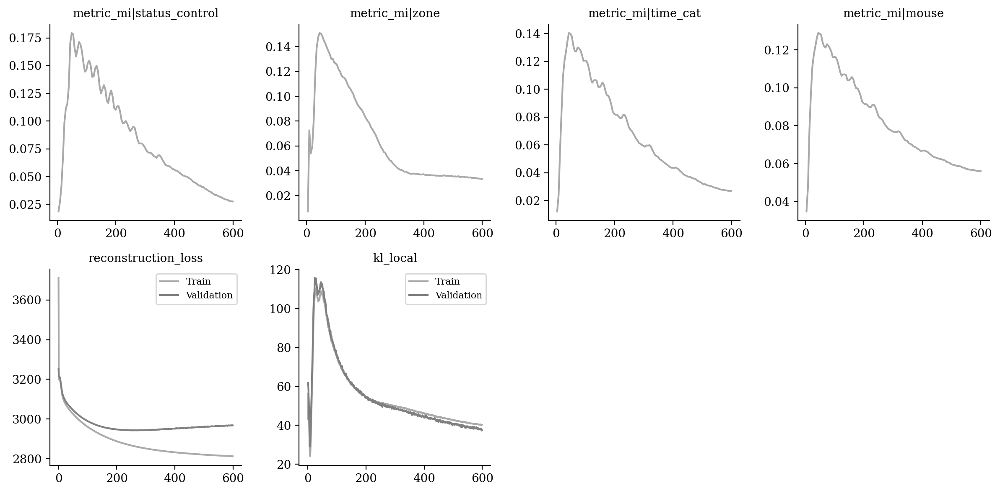

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

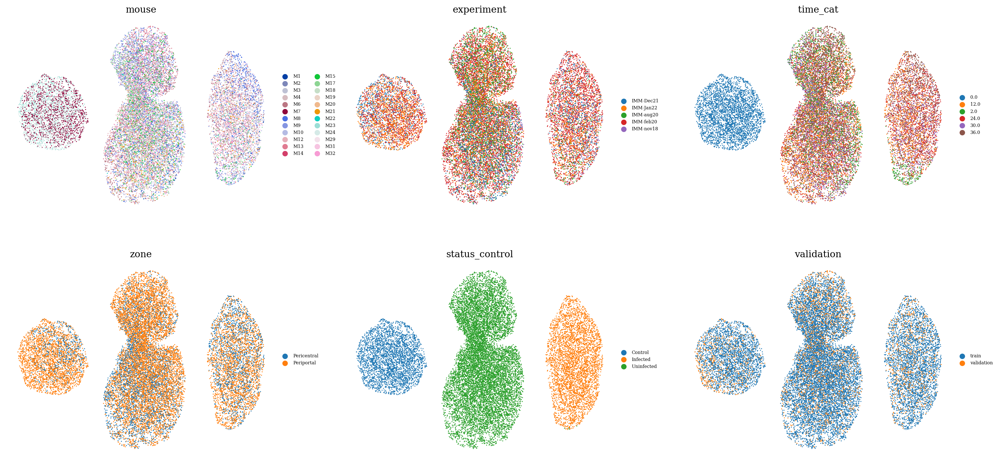

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

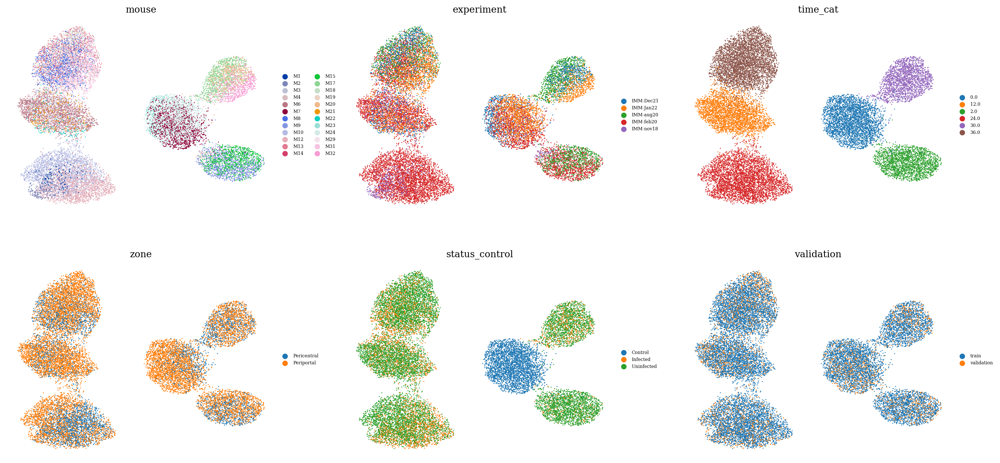

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

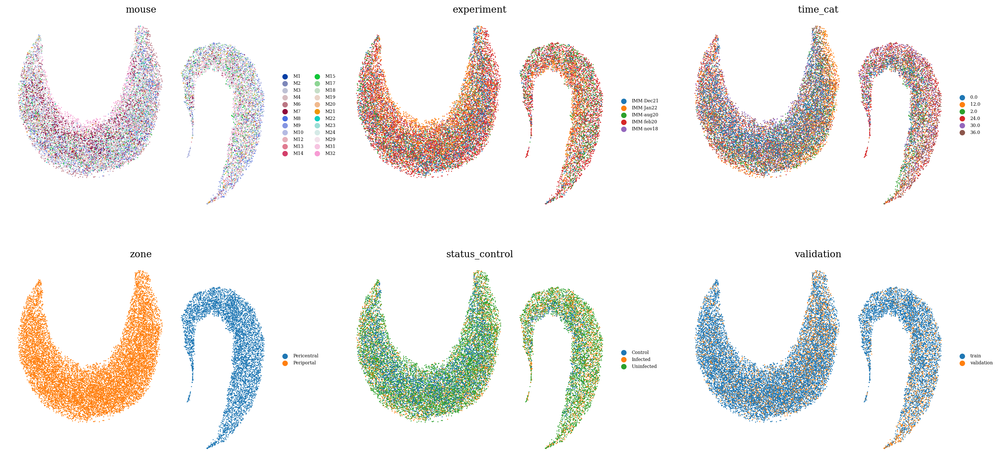

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

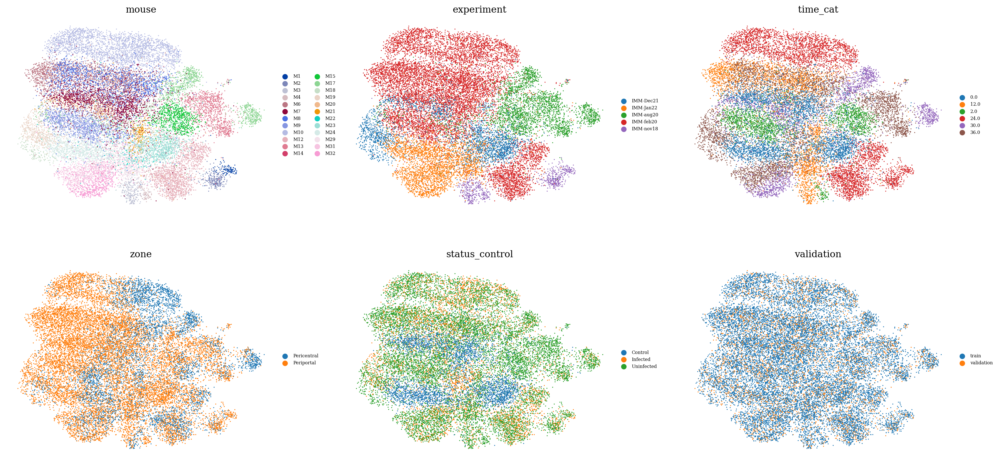

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

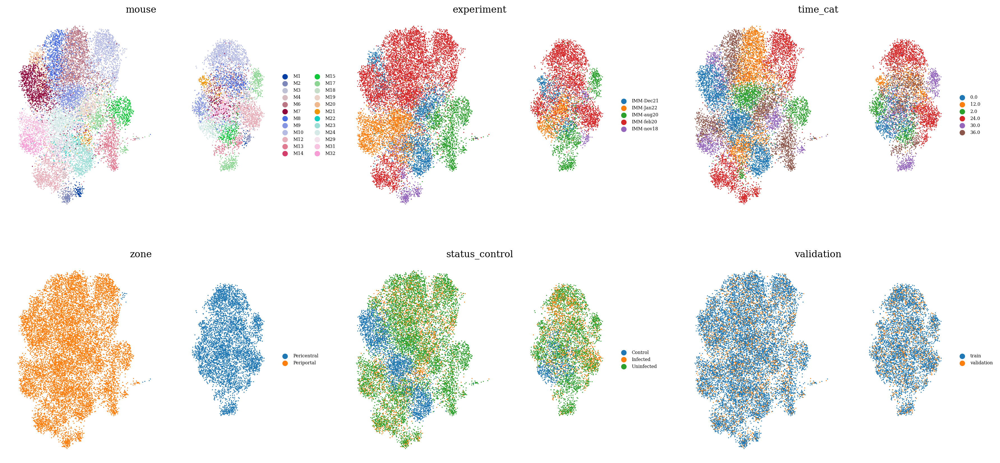

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

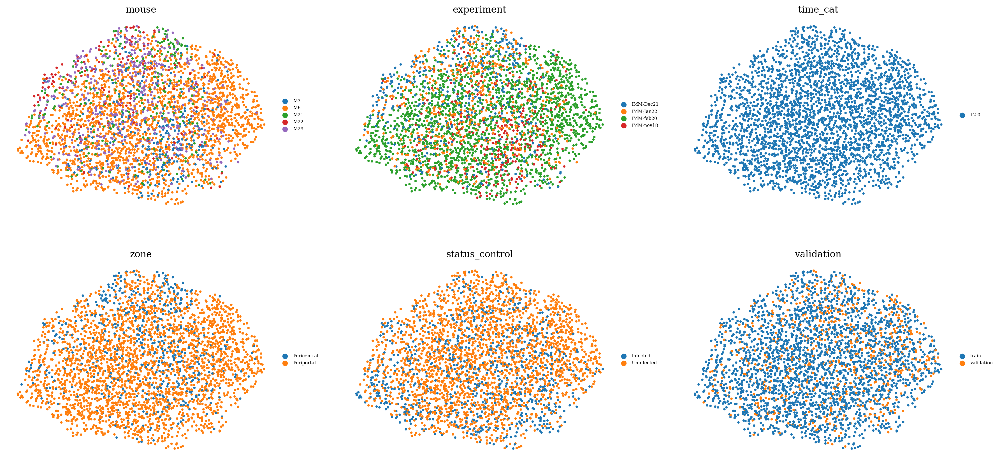

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )